<div class="alert alert-block alert-info">
<center> <h1> DATA MINING - PROJECT </h1> </center> <br>
<center> <h2> Group 04 - Part 2 </h2> </center> <br>
    <center> <h3> 2024/2025 </h3> </center>

Student Name - Beatriz Monteiro <br>
Student id - 20240591 <br>
Contact e-mail - 20240591@novaims.unl.pt <br>

Student Name - Luís Semedo <br>
Student id - 20240852 <br>
Contact e-mail - 20240852@novaims.unl.pt <br>

Student Name - Pedro Santos <br>
Student id - 20240295 <br>
Contact e-mail - 20240295@novaims.unl.pt <br>

Student Name - Rodrigo Miranda <br>
Student id - 20240490 <br>
Contact e-mail - 20240490@novaims.unl.pt <br>

# Metadata
- *customer_id* - Unique identifier for each customer
- *customer_region* - Geographic region where the customer is located
- *customer_age* - Age of the customer
- *vendor_count* - Number of unique vendors the customer has ordered from
- *product_count* - Total number of products the customer has ordered
- *is_chain* - Indicates whether the customer’s order was from a chain restaurant
- *first_order* - Number of days from the start of the dataset when the customer first placed an order
- *last_order* - Number of days from the start of the dataset when the customer most recently placed an order
- *last_promo* - The category of the promotion or discount most recently used by the customer
- *payment_method* - Method most recently used by the customer to pay for their orders
- *CUI_American,CUI_Asian,CUI_Chinese,CUI_Italian, etc.* - The amount in monetary units spent by the customer from the indicated type of cuisine
- *DOW_0 to DOW_6* - Number of orders placed on each day of the week (0 =Sunday, 6 =Saturday)
- *HR_0 to HR_23* - Number of orders placed during each hour of the day (0 =midnight, 23 = 11 PM)

<a id = "Index"></a>

# Part 2 Project Index

* [1. Imports](#imports)
   * [1.1. Import Libraries](#importlibraries)
   * [1.2. Import Data](#importdata)

* [2. Data Preparation](#Data-Preparation)
   * [2.1. Duplicates](#Duplicates)
   * [2.2. Feature Engineering](#Feature-Engineering)
   * [2.3. Inconsistent Data](#Inconsistent-Data)
   * [2.4. Missing values](#Missing-values)
   * [2.5. Scaling](#scaling)
   * [2.6. Encoding](#Encoding) 
   * [2.7. Feature Selection - 1st Part](#Feature-Selection1)

* [3. Clustering](#Clustering)
   * [3.1. SOM - All Numeric Features](#SOM-All)
   * [3.2. Perspectives](#Perspectives)
   * [3.3. Outliers](#Outliers)
      * [3.3.1. DBScan](#DBScan)
      * [3.3.2. DBScan + Manual](#DBScan+Manual)
      * [3.3.3. 99% Quantile](#99Quantile)
      * [3.3.4. Methods Comparison](#Comparison)
   * [3.4. SOM - Value Perspective Features](#SOM-Value)
   * [3.5. SOM - Preference Perspective Features](#SOM-Preference)
   * [3.6. Feature Selection - 2nd Part](#Feature-Selection2)
   * [3.7. K-means and Hierarchical Clustering](#Outliers)
   * [3.8. Cluster Analysis](#ClusterAnalysis)
* [4. Profilling](#Profilling)
   * [4.1. Non used metric features](#Non_used)
   * [4.2. Categorical features](#Categorical_features)
   * [4.3. Clustering Visualization](#Clustering_Visualization)
      * [4.3.1. t-SNE](#t-SNE)
      * [4.3.2. UMAP](#UMAP)
* [5. Assess feature importance and reclassify outliers](#feature_importance_reclassify_outliers)
   * [5.1. Feature Importance](#Feature_Importance)
      * [5.1.1. Using the $R^2$](#$R^2$)
      * [5.1.2. Using a Decision Tree](#Decision_Tree)
   * [5.2. Reclassify Outliers](#Reclassify_Outliers)
      * [5.2.1. Without Outliers](#Without_Outliers)
      * [5.2.2. Outliers](#_Outliers)

<hr>
<a class="anchor" id="imports">
    
# 1. Imports

</a>

<a class="anchor" id="importlibraries">

## 1.1. Import Libraries

</a>

In [546]:
# !pip install umap-learn
# !pip install graphviz
# !pip install minisom

In [1]:
# Basic Data Manipulation
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import RegularPolygon
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib import colors as mpl_colors

# Clustering Algorithms
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.neighbors import NearestNeighbors
from scipy.cluster.hierarchy import dendrogram

# Dimensionality Reduction
from sklearn.manifold import TSNE
import umap

# Self-Organizing Maps (SOM)
from minisom import MiniSom

# Classification
from sklearn.tree import DecisionTreeClassifier, export_graphviz

# Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder

# Imputation
from sklearn.impute import KNNImputer

# Model Evaluation and Utilities
from sklearn.base import clone

# Train-Test Split
from sklearn.model_selection import train_test_split

from math import ceil
from os.path import join
from IPython.display import Image
import graphviz

# Handle Warnings
import warnings
warnings.filterwarnings('ignore')

# Inline Jupyter Settings
%config InlineBackend.figure_format = 'retina'

# Set Seaborn Style
sns.set()

In [2]:
pd.set_option('display.max_columns', None)

<a class="anchor" id="importdata">

## 1.2. Import Data

</a>

In [4]:
# Opening our dataset
df = pd.read_csv('DM2425_ABCDEats_DATASET.csv')

<a class="anchor" id="Data-Preparation">

# 2. Data Preparation

</a>

In [5]:
df_pre = df.copy()

<a class="anchor">

## 2.1. Duplicates

In [6]:
unique_IDs = df_pre['customer_id'].nunique()
total_rows = len(df_pre)

print(f"The customer_id column has {unique_IDs} unique values,\nand the dataframe df_pre has {total_rows} rows.")


The customer_id column has 31875 unique values,
and the dataframe df_pre has 31888 rows.


In [7]:
df_pre[df_pre.duplicated(subset=['customer_id'], keep=False)]

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
3355,b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3379,b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,93.43,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,3,2,3,1,1,0,0,0.0,0,0,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7867,24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
7887,24251eb7da,8550,28.0,4,8,3,7.0,85,-,CARD,30.44,18.54,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,32.27,0.0,1,0,3,0,0,0,1,0.0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
16227,671bf0c738,8550,25.0,4,7,3,23.0,66,FREEBIE,CARD,56.18,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,30.53,0.0,0,1,1,1,0,1,0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0
16230,671bf0c738,8550,25.0,4,7,3,23.0,66,FREEBIE,CARD,56.18,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,30.53,0.0,0,1,1,1,0,1,0,0.0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0
20855,742ca068fc,8550,20.0,1,2,0,35.0,35,-,CARD,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,31.57,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
20907,742ca068fc,8550,20.0,1,2,0,35.0,35,-,CARD,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,31.57,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
24328,df91183978,8550,23.0,2,3,1,47.0,52,DELIVERY,CARD,0.00,18.78,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,17.34,0.0,0,0,1,0,1,0,0,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
24329,df91183978,8550,23.0,2,3,1,47.0,52,DELIVERY,CARD,0.00,18.78,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,17.34,0.0,0,0,1,0,1,0,0,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [8]:
df_pre.drop_duplicates(subset=['customer_id'], keep='first', inplace=True)
df_pre

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,0.00,0.00,0.00,0.0,0.0,0.0,0.00,0.0,28.88,0.00,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,12.82,6.39,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,9.20,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,0.00,13.70,0.00,0.0,0.0,0.0,0.00,0.0,17.86,0.00,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,14.57,40.87,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31883,f4e366c281,8670,30.0,1,1,1,NaN,0,FREEBIE,DIGI,0.00,0.00,18.04,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
31884,f6b6709018,8670,NaN,1,1,0,NaN,0,DELIVERY,DIGI,18.04,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
31885,f74ad8ce3f,8670,24.0,1,1,1,NaN,0,-,DIGI,0.00,0.00,0.00,0.0,0.0,0.0,17.79,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31886,f7b19c0241,8670,34.0,1,1,0,NaN,0,DISCOUNT,DIGI,0.00,12.03,0.00,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


We can see that the rows with the duplicate IDs have actually the same values in every column as the row of the original ID, so we can set the idex without losing any import info.

In [9]:
# Set customer_id as the index for df_pre
df_pre.set_index('customer_id', inplace=True)

<a class="anchor">

## 2.2. Feature Engineering

We will quickly recreate the features made in the EDA since we decided to import the original dataset instead of the one transformed in EDA to avoid inconveniences.

In [556]:
# Here we create some lists to help in future possible usages

CUI = ['CUI_American', 'CUI_Asian', 'CUI_Street Food / Snacks', 'CUI_Italian', 'CUI_OTHER', 'CUI_Japanese', 'CUI_Beverages', 'CUI_Indian',
       'CUI_Chinese', 'CUI_Healthy', 'CUI_Desserts', 'CUI_Thai', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Noodle Dishes']

In [557]:
df_pre['weekdays'] = df_pre[['DOW_1', 'DOW_2', 'DOW_3','DOW_4', 'DOW_5']].sum(axis=1)
df_pre['weekend'] = df_pre[['DOW_6', 'DOW_0']].sum(axis=1)

df_pre['CUI_Popular_Asian'] = df_pre[['CUI_Japanese', 'CUI_Chinese', 'CUI_Thai', 'CUI_Indian', 'CUI_Noodle Dishes']].sum(axis=1)
df_pre['CUI_Western'] = df_pre[['CUI_American', 'CUI_Italian']].sum(axis=1)
df_pre['CUI_Other_Cuisines'] = df_pre[['CUI_OTHER', 'CUI_Cafe', 'CUI_Beverages', 'CUI_Desserts', 'CUI_Healthy', "CUI_Chicken Dishes"]].sum(axis=1)

df_pre['total_orders'] = df_pre[['DOW_1', 'DOW_2', 'DOW_3','DOW_4', 'DOW_5', 'DOW_6', 'DOW_0']].sum(axis=1) #we use the days because Hours have NaNs, this will be adressed below

df_pre['promo_used'] = df_pre['last_promo'].apply(lambda x: 0 if x == '-' else 1)

df_pre['total_money_spent'] = df_pre[CUI].sum(axis=1)

df_pre['avg_spent_per_order'] = df_pre['total_money_spent']/df_pre['total_orders']


df_pre['different_CUI'] = 0
for index, row in df_pre.iterrows():
    count = 0 
    for column in CUI:
        if row[column] > 0:
            count += 1
    df_pre.at[index, 'different_CUI'] = count


# Features that will be created only below because some problems need to be addressed first:
# peak_hours
# off_peak_hours
# customer_time
# customer_frequency
# avg_spent_per_product - product_count = 0 will be removed
# avg_products_per_order - product_count = 0 will be removed


##### Proportions for Cuisines
df_pre["proportion_CUI_popular_asian"] = df_pre["CUI_Popular_Asian"] / df_pre["total_money_spent"]

df_pre["proportion_CUI_western"] = df_pre["CUI_Western"] / df_pre["total_money_spent"]

df_pre["proportion_CUI_asian"] = df_pre["CUI_Asian"] / df_pre["total_money_spent"]

df_pre["proportion_CUI_other_cuisines"] = df_pre["CUI_Other_Cuisines"] / df_pre["total_money_spent"]

df_pre["proportion_CUI_Street Food / Snacks"] = df_pre["CUI_Street Food / Snacks"] / df_pre["total_money_spent"]


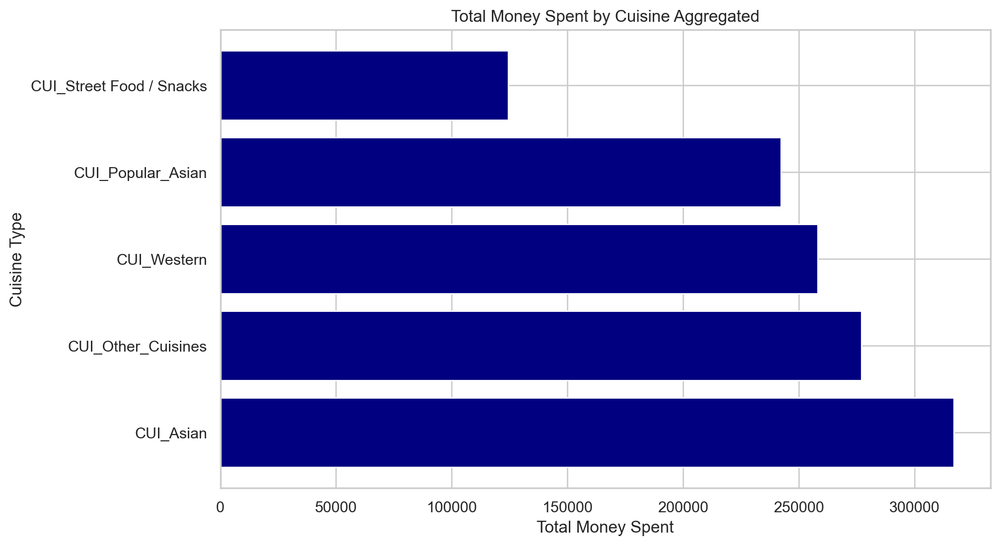

In [558]:
CUI_Aggregated = ['CUI_Popular_Asian', 'CUI_Western', 'CUI_Other_Cuisines', 'CUI_Street Food / Snacks', 'CUI_Asian']

# Calculate the total of total_money_spent for each cuisine category
total_money_spent = df_pre[CUI_Aggregated].sum()

# Sort the values
total_money_spent_sorted = total_money_spent.sort_values(ascending=False)

sns.set_style("whitegrid")
# Create the bar chart with the values and categories sorted
plt.figure(figsize=(10, 6))
plt.barh(total_money_spent_sorted.index, total_money_spent_sorted, color='navy')

# Add title and labels
plt.title('Total Money Spent by Cuisine Aggregated')
plt.xlabel('Total Money Spent')
plt.ylabel('Cuisine Type')
plt.xticks(rotation=0)

# Show the graph
plt.show()

For the cases where Total Money Spent is zero the Proportions will be NaN so we will fill these cases with 0. This will be temporary because all the cases where this happen are the same cases where product_count = 0 and this will be adressed below

In [559]:
proportion_columns = [
    "proportion_CUI_popular_asian", 
    "proportion_CUI_western", 
    "proportion_CUI_asian", 
    "proportion_CUI_other_cuisines", 
    "proportion_CUI_Street Food / Snacks"
]

df_pre[proportion_columns] = df_pre[proportion_columns].fillna(0)

print(df_pre[proportion_columns].isna().sum())


proportion_CUI_popular_asian           0
proportion_CUI_western                 0
proportion_CUI_asian                   0
proportion_CUI_other_cuisines          0
proportion_CUI_Street Food / Snacks    0
dtype: int64


In [560]:
df_pre[df_pre['total_money_spent']==0]['product_count'].unique()

array([0], dtype=int64)

Update the metric features and non metric features:

In [561]:
# We can represent which variables are numeric and which are not.
non_metric_features = df_pre.select_dtypes(include=["object", "category"])
metric_features = df_pre.select_dtypes(include = 'number')

#promo_used is a binary feature, so we change its location to the non_metric_features
metric_features = metric_features.drop('promo_used', axis=1)
non_metric_features['promo_used'] = df_pre['promo_used']

print(metric_features.columns)
print(non_metric_features.columns)

Index(['customer_age', 'vendor_count', 'product_count', 'is_chain',
       'first_order', 'last_order', 'CUI_American', 'CUI_Asian',
       'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese',
       'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
       'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER',
       'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2',
       'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3',
       'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11',
       'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19',
       'HR_20', 'HR_21', 'HR_22', 'HR_23', 'weekdays', 'weekend',
       'CUI_Popular_Asian', 'CUI_Western', 'CUI_Other_Cuisines',
       'total_orders', 'total_money_spent', 'avg_spent_per_order',
       'different_CUI', 'proportion_CUI_popular_asian',
       'proportion_CUI_western', 'proportion_CUI_asian',
       'proportion_CUI_other_cuisines', 'proportion_CUI_St

<a class="anchor">

## 2.3. Inconsistent Data

### last_order

In [562]:
df_pre[df_pre['last_order']<df_pre['first_order']]

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,weekdays,weekend,CUI_Popular_Asian,CUI_Western,CUI_Other_Cuisines,total_orders,promo_used,total_money_spent,avg_spent_per_order,different_CUI,proportion_CUI_popular_asian,proportion_CUI_western,proportion_CUI_asian,proportion_CUI_other_cuisines,proportion_CUI_Street Food / Snacks
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


No inconsistencies in this case.

In [563]:
df_pre[df_pre['last_order']==0]['first_order'].unique()

array([nan])

We will check if last_order = 0 is a reasonable value or not.

In [564]:
df_pre[df_pre['last_order']==0]['total_orders'].value_counts()

total_orders
1    104
2      2
Name: count, dtype: int64

It seems to be a reasonable value!

In [565]:
df_pre[df_pre['first_order'].isnull()]['last_order'].unique()

array([0], dtype=int64)

We see that in every case where last_order is 0 the first_order is NaN and vice-versa.

We are going to fill first_order as 0 for these cases.

In [566]:
df_pre.loc[:, 'first_order']= df_pre.loc[:, 'first_order'].fillna(0)

In [567]:
df_pre['customer_time'] = df_pre['last_order'] - df_pre['first_order']
df_pre['customer_frequency'] = df_pre['product_count']/df_pre['customer_time'] #Rever esta variável
df_pre.loc[df_pre['customer_time'] == 0, 'customer_frequency'] = 0

In [568]:
df_pre['customer_time'].describe()

count    31828.000000
mean        35.299202
std         29.437903
min          0.000000
25%          3.000000
50%         34.000000
75%         62.000000
max         90.000000
Name: customer_time, dtype: float64

### product_count

In [569]:
df_pre[df_pre['product_count']==0]

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,weekdays,weekend,CUI_Popular_Asian,CUI_Western,CUI_Other_Cuisines,total_orders,promo_used,total_money_spent,avg_spent_per_order,different_CUI,proportion_CUI_popular_asian,proportion_CUI_western,proportion_CUI_asian,proportion_CUI_other_cuisines,proportion_CUI_Street Food / Snacks,customer_time,customer_frequency
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
4903041977,8670,22.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
c94b288475,8670,26.0,0,0,0,1.0,1,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
f687717dc1,8670,21.0,0,0,1,1.0,1,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
c6cf0b76fb,8670,38.0,0,0,0,2.0,2,DELIVERY,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1b7c34738e,8670,24.0,0,0,0,3.0,3,-,CASH,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,0,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0039059c9c,8670,22.0,0,0,1,88.0,88,DISCOUNT,CARD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0e60632fe2,8670,23.0,0,0,0,89.0,89,DISCOUNT,CARD,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28ed1f1e3f,8670,20.0,0,0,0,89.0,89,DELIVERY,DIGI,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0,1,0.0,NaN,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We are going to remove these lines since they seem to be an error.

In [570]:
df_pre = df_pre[df_pre['product_count']!=0]

In [571]:
df_pre['avg_spent_per_product'] = df_pre['total_money_spent'] / df_pre['product_count']
df_pre['avg_spent_per_product'].max()

24.39

In [572]:
df_pre['avg_products_per_order'] = df_pre['product_count']/df_pre['total_orders']
df_pre['avg_products_per_order'].max()

6.0

### last_promo

In [573]:
df_pre.loc[df_pre['last_promo'] == '-', 'last_promo'] = 'NO_PROMO'
df_pre['last_promo'].unique()

array(['DELIVERY', 'DISCOUNT', 'NO_PROMO', 'FREEBIE'], dtype=object)

### is_chain

The feature is_chain does not seem appropriate for various reasons. This feature should be binary, representing whether the customer purchased or not from a chain restaurant. Therefore, we believe that given the numerous amount of values that differ from 0/1, this feature should actually be representative of the number of times the customer ordered from a chain restaurant. This was already justified in our EDA. Hence, an appropriate reformulation of this feature is the only necessary step to solve this inconsistency.

In [574]:
df_pre["orders_from_chain"] = df_pre["is_chain"]

<a class="anchor">

## 2.4. Missing Values

#### HR_0

We know that the Total Number of Orders is represented by the hours and by the days, which means the sum of all days and all hours should be the same. <br>
We will analyse this.

In [575]:
df_pre['HR_0'].isnull().sum()

1164

In [576]:
total_hours = df_pre[[f'HR_{i}' for i in range(24)]].sum(axis=1)
total_days = df_pre[[f'DOW_{i}' for i in range(7)]].sum(axis=1)

df_pre['Diff_Hours_Days'] = total_hours - total_days

df_pre[df_pre['Diff_Hours_Days']!=0]['HR_0']

customer_id
ae38da6386   NaN
a21a839c77   NaN
9237d23413   NaN
8c6ffd7357   NaN
67c6c9f9c4   NaN
              ..
37b72b449d   NaN
ac382ddfd1   NaN
96f1fc25e3   NaN
d7c7face7e   NaN
6624e03cdd   NaN
Name: HR_0, Length: 1164, dtype: float64

In [577]:
df_pre[df_pre['Diff_Hours_Days']!=0]['HR_0'].unique()

array([nan])

As expected, the difference is always caused by HR_0 being a NaN. We will impute HR_0 as the difference of total_hours and total_days in the cases it isn't 0.

In [578]:
rows_with_diff = df_pre[df_pre['Diff_Hours_Days'] != 0]

for index, row in rows_with_diff.iterrows():
    diff_value = abs(row['Diff_Hours_Days'])
    df_pre.at[index, 'HR_0'] = diff_value 

In [579]:
#Redifining to chek if it is all ok - we expect Diff_Hours_Days to be always zero

total_hours = df_pre[[f'HR_{i}' for i in range(24)]].sum(axis=1)
total_days = df_pre[[f'DOW_{i}' for i in range(7)]].sum(axis=1)

df_pre['Diff_Hours_Days'] = total_hours - total_days
print(df_pre['Diff_Hours_Days'].unique())

df_pre = df_pre.drop(columns=['Diff_Hours_Days'])

[0.]


In [580]:
df_pre['HR_0'].isnull().sum()

0

Note: Since the HR_0 has been succesfully imputed, we must now include it in our "off_peak_hours" variable. 


In [581]:
off_peak_hours = df_pre["HR_0"] + df_pre["HR_1"] + df_pre["HR_2"] + df_pre["HR_3"] + df_pre["HR_4"] +df_pre["HR_5"] + df_pre["HR_6"] + df_pre["HR_7"] + df_pre["HR_8"] + df_pre["HR_9"] + df_pre["HR_13"] + df_pre["HR_14"] + df_pre["HR_19"] + df_pre["HR_20"] + df_pre["HR_21"] + df_pre["HR_22"] + df_pre["HR_23"]
peak_hours = df_pre["HR_10"] + df_pre["HR_11"] + df_pre["HR_12"] + df_pre["HR_15"] + df_pre["HR_16"] + df_pre["HR_17"] + df_pre["HR_18"]


In [582]:
df_pre["off_peak_hours"] = off_peak_hours
df_pre["peak_hours"] = peak_hours

#### Proportion Hours
df_pre["proportion_off_peak_hours"] = df_pre["off_peak_hours"] / (df_pre["off_peak_hours"] + df_pre["peak_hours"])
df_pre["proportion_peak_hours"] =  df_pre["peak_hours"] / (df_pre["off_peak_hours"] + df_pre["peak_hours"])

Making variables log.

In [583]:
# df_pre['Log_Total_Money_Spent'] = np.log1p(df_pre['total_money_spent'])
# df_pre['Log_Total_Orders'] = np.log1p(df_pre['total_orders'])
# df_pre['Log_avg_spent_per_product'] = np.log1p(df_pre['avg_spent_per_product'])
# df_pre['Log_customer_time'] =np.log1p(df_pre['customer_time'])
# df_pre['Log_orders_from_chain'] =np.log1p(df_pre['orders_from_chain'])

<a class="anchor">

#### Metric and Non-Metric Features

In [584]:
metric_features = df_pre.select_dtypes(include=np.number)
metric_features.columns

metric_features = metric_features.drop('promo_used', axis=1)
non_metric_features['promo_used'] = df_pre['promo_used']

In the following section we will treat the missing values with the KNN imputer after scaling.
The need for scaling before KNNImputer is mandatory, given that KNNImputer works based on distance. Therefore having our numerical features scaled is very important.

<a class="anchor">

## 2.5. Scaling

Between the Standard scaler and the minmax scaler we are going to analyse which method is better:

In [585]:
scaler = MinMaxScaler()
metric_features_minmax = pd.DataFrame(scaler.fit_transform(metric_features), columns=metric_features.columns, index=metric_features.index)

In [586]:
scaler = StandardScaler()
metric_features_standard = pd.DataFrame(scaler.fit_transform(metric_features), columns=metric_features.columns, index=metric_features.index)

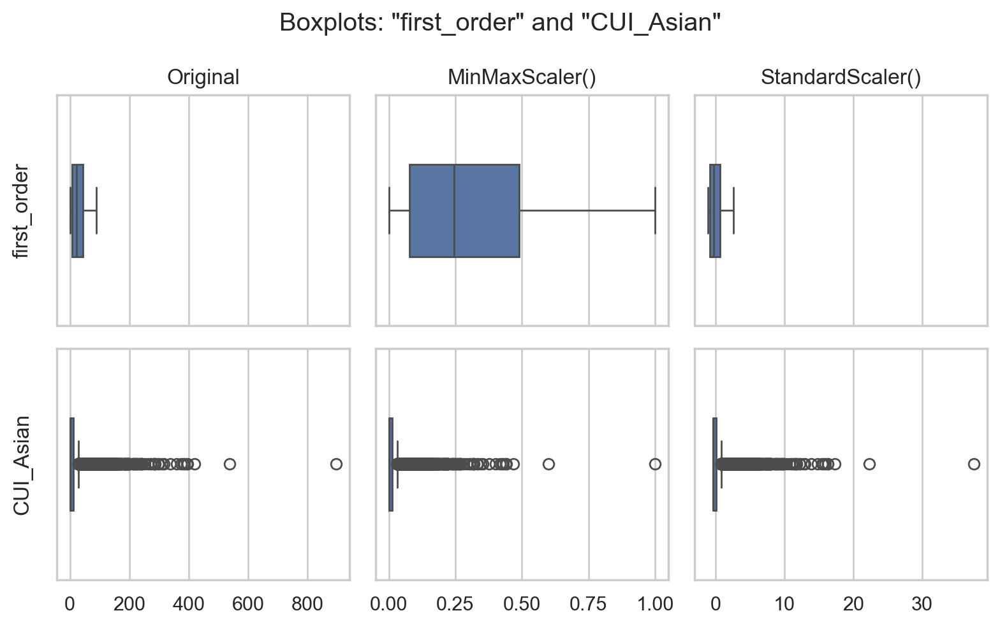

In [587]:
sns.set_style('whitegrid')
fig, axes = plt.subplots(2,3, figsize=(8,5), tight_layout=True, sharex='col', sharey='row')

bp_feat_l = 'first_order'

sns.boxplot(metric_features, x=bp_feat_l, ax=axes[0][0], width=.4)
axes[0][0].set_title('Original')
axes[0][0].set_ylabel(bp_feat_l)

sns.boxplot(metric_features_minmax, x=bp_feat_l, ax=axes[0][1], width=.4)
axes[0][1].set_title('MinMaxScaler()')

sns.boxplot(metric_features_standard, x=bp_feat_l, ax=axes[0][2], width=.4)
axes[0][2].set_title('StandardScaler()')

bp_feat_r = 'CUI_Asian'

sns.boxplot(metric_features, x=bp_feat_r, ax=axes[1][0], width=.4)
axes[1][0].set_ylabel(bp_feat_r)

sns.boxplot(metric_features_minmax, x=bp_feat_r, ax=axes[1][1], width=.4)

sns.boxplot(metric_features_standard, x=bp_feat_r, ax=axes[1][2], width=.4)

axes[1][0].set_xlabel(None)
axes[1][1].set_xlabel(None)
axes[1][2].set_xlabel(None)

fig.suptitle('Boxplots: "{}" and "{}"'.format(bp_feat_l, bp_feat_r))
plt.show()

We chose StandardScaler because our analysis involves retaining many outliers, and we won't be performing extensive outlier removal. StandardScaler centers the data around the mean and scales it by the standard deviation, ensuring that outliers are proportionately represented rather than excessively compressed, as might occur with MinMaxScaler. This choice is particularly suited to our needs, as it preserves the interpretability of the dataset's variance, which is critical for visualizations like parallel coordinate plots.

In [588]:
scaler = StandardScaler()
metric_features_scaled = pd.DataFrame(scaler.fit_transform(metric_features), columns=metric_features.columns, index=metric_features.index)
metric_features_notscaled = metric_features.copy() #used for testing other outliers methods

<a class="anchor">

### KNN Imputer

In [589]:
imputer = KNNImputer()
metric_features_scaled = pd.DataFrame(imputer.fit_transform(metric_features_scaled), columns=metric_features_scaled.columns, index=metric_features_scaled.index)

<a class="anchor">

## 2.6. Encoding

In [590]:
for col in non_metric_features.columns:
    df_pre["last_promo"] = df_pre["last_promo"].replace("-","NO PROMO USED")
    non_metric_features["last_promo"] = non_metric_features["last_promo"].replace("-","NO PROMO USED")

In [591]:
for col in non_metric_features.columns:
    df_pre["customer_region"] = df_pre["customer_region"].replace("-","8000")
    non_metric_features["customer_region"] = non_metric_features["customer_region"].replace("-","8000")


In [592]:
# We use OneHotEncoder to encode the categorical features. 
ohc = OneHotEncoder(sparse_output=False, drop=None)

In [593]:
# We are going to encond the non numeric features, with the exception of the binary variable promo_used
ohc_features = non_metric_features.drop(columns=["promo_used"])

In [594]:
ohc_feat = ohc.fit_transform(ohc_features)
ohc_feat_names = ohc.get_feature_names_out()  #Get feature names

In [595]:
# We now create a DataFrame with the one-hot encoded categorical features
ohc_df = pd.DataFrame(ohc_feat, index=ohc_features.index, columns=ohc_feat_names)  
ohc_df

,customer_region_2360,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8000,customer_region_8370,customer_region_8550,customer_region_8670,last_promo_DELIVERY,last_promo_DISCOUNT,last_promo_FREEBIE,last_promo_NO PROMO USED,payment_method_CARD,payment_method_CASH,payment_method_DIGI
customer_id,,,,,,,,,,,,,,,,
1b8f824d5e,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
5d272b9dcb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
f6d1b2ba63,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
180c632ed8,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
4eb37a6705,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
f6b6709018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
f74ad8ce3f,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [596]:
# Supondo que a coluna 'customer_id' seja a chave para o merge
df_pre = df_pre.merge(ohc_df, how='left', on='customer_id')
df_pre.head()

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6,HR_0,HR_1,HR_2,HR_3,HR_4,HR_5,HR_6,HR_7,HR_8,HR_9,HR_10,HR_11,HR_12,HR_13,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23,weekdays,weekend,CUI_Popular_Asian,CUI_Western,CUI_Other_Cuisines,total_orders,promo_used,total_money_spent,avg_spent_per_order,different_CUI,proportion_CUI_popular_asian,proportion_CUI_western,proportion_CUI_asian,proportion_CUI_other_cuisines,proportion_CUI_Street Food / Snacks,customer_time,customer_frequency,avg_spent_per_product,avg_products_per_order,orders_from_chain,off_peak_hours,peak_hours,proportion_off_peak_hours,proportion_peak_hours,customer_region_2360,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8000,customer_region_8370,customer_region_8550,customer_region_8670,last_promo_DELIVERY,last_promo_DISCOUNT,last_promo_FREEBIE,last_promo_NO PROMO USED,payment_method_CARD,payment_method_CASH,payment_method_DIGI
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,28.88,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,2,28.88,0.00,0.0,2,1,28.88,14.440,1,1.000000,0.000000,0.000000,0.0,0.0,1.0,5.0,5.776,2.5,1,0.0,2,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,12.82,6.39,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0.00,12.82,0.0,2,1,19.21,9.605,2,0.000000,0.667361,0.332639,0.0,0.0,1.0,2.0,9.605,1.0,2,0.0,2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,9.20,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0.00,9.20,0.0,2,1,9.20,4.600,1,0.000000,1.000000,0.000000,0.0,0.0,1.0,2.0,4.600,1.0,2,1.0,1,0.5,0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,0.00,13.70,0.0,0.0,0.0,0.0,0.0,0.0,17.86,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,1,17.86,0.00,0.0,2,1,31.56,15.780,2,0.565906,0.000000,0.434094,0.0,0.0,2.0,1.5,10.520,1.5,1,1.0,1,0.5,0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
4eb37a6705,4660,20.0,2,5,0,0.0,2,NO_PROMO,DIGI,14.57,40.87,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,1,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0.00,14.57,0.0,2,0,55.44,27.720,2,0.000000,0.262807,0.737193,0.0,0.0,2.0,2.5,11.088,2.5,0,2.0,0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [597]:
## Rename OHE columns from "feature_val_a" to "oh_feature_val_a"
## We do this to be able to distinguish the OHE columns more easily later

## Assemble OHE columns and their new column names
rename_ohe_cols = {}

for i in non_metric_features.columns:
    for j in df_pre.columns[df_pre.columns.str.startswith(i)].to_list() :
        if j not in non_metric_features:
            rename_ohe_cols[j] = 'oh_' + j

df_pre.rename(columns=rename_ohe_cols, inplace=True)

In [598]:
df_pre.columns

Index(['customer_region', 'customer_age', 'vendor_count', 'product_count',
       'is_chain', 'first_order', 'last_order', 'last_promo', 'payment_method',
       'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai', 'DOW_0', 'DOW_1',
       'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6', 'HR_0', 'HR_1', 'HR_2',
       'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10',
       'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18',
       'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23', 'weekdays', 'weekend',
       'CUI_Popular_Asian', 'CUI_Western', 'CUI_Other_Cuisines',
       'total_orders', 'promo_used', 'total_money_spent',
       'avg_spent_per_order', 'different_CUI', 'proportion_CUI_popular_asian',
       'proportion_CUI_western', 'proportion_CUI_a

<a class="anchor">

## 2.7. Feature Selection - 1st Part

Following the feature engineering process where we aggregated various features and created new ones, we will now eliminate features to avoid repeated information, reduce redundancy, and enhance relevance:

### Repeated information

The new feature `Weekdays` is the sum of the `DOW_1` to `DOW_5`, so we are going to drop these last 5 features.
Following the same reasoning, the new feature `Weekend` is the sum of `DOW_6` and `DOW_0`, so we drop the last 2 features.

`CUI_Popular_Asian`is an agregation of `CUI_Japanese`, `CUI_Chinese`, `CUI_Thai`, `CUI_Indian` and `CUI_Noodle Dishes`, so we will keep the new feature and drop these last 5 features.

`CUI_Western` is also an agregation of `CUI_American` and `CUI_Italian`, so we keep the new feature and drop these last two features.

The new feature `orders_from_chain` is the correct interpretation of the old feature `is_chain`, so we we keep the new feature and drop the old one.

Finally, `Other_Cuisines` is an agregation of `CUI_OTHER`, `CUI_Cafe`, `CUI_Beverages`, `CUI_Desserts` and `CUI_Healthy`, so we keep the new feature again and drop these last 5 features. 

In [599]:
# Drop specified columns and range-based columns
columns_to_drop_not_profiling = ['CUI_Japanese', 'CUI_Chinese', 'CUI_Thai', 'CUI_Indian', 'CUI_Noodle Dishes', 
                   'CUI_American', 'CUI_Italian','CUI_OTHER', 'CUI_Cafe', 'CUI_Beverages', 'CUI_Desserts',
                   'CUI_Healthy', 'CUI_Chicken Dishes', 'is_chain' ]#"off_peak_hours", "peak_hours"]

# Add HR_0 to HR_23 and DOW_0 to DOW_6
columns_to_drop = [f"HR_{i}" for i in range(24)]  # HR_0 to HR_23
columns_to_drop += [f"DOW_{i}" for i in range(7)]  # DOW_0 to DOW_6

# # Drop the columns in the data frame df_pre
df_pre = df_pre.drop(columns=columns_to_drop)
df_profiling = df_pre.copy()
df_pre.drop(columns=columns_to_drop_not_profiling)

# Update the columns in the data frame metric_features
metric_features_scaled = metric_features_scaled.drop(columns=columns_to_drop)
metric_features_scaled_profiling = metric_features_scaled.copy()
metric_features_scaled = metric_features_scaled.drop(columns=columns_to_drop_not_profiling)

metric_features_notscaled = metric_features_notscaled.drop(columns=columns_to_drop)
metric_features_notscaled_profiling = metric_features_notscaled.copy()
metric_features_notscaled = metric_features_notscaled.drop(columns=columns_to_drop_not_profiling)

print("Remaining columns:", df_pre.columns)
print("Metric features columns:", metric_features_scaled.columns)

#REMARK: we are only considering metric features

Remaining columns: Index(['customer_region', 'customer_age', 'vendor_count', 'product_count',
       'is_chain', 'first_order', 'last_order', 'last_promo', 'payment_method',
       'CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe',
       'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy',
       'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes',
       'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai', 'weekdays',
       'weekend', 'CUI_Popular_Asian', 'CUI_Western', 'CUI_Other_Cuisines',
       'total_orders', 'promo_used', 'total_money_spent',
       'avg_spent_per_order', 'different_CUI', 'proportion_CUI_popular_asian',
       'proportion_CUI_western', 'proportion_CUI_asian',
       'proportion_CUI_other_cuisines', 'proportion_CUI_Street Food / Snacks',
       'customer_time', 'customer_frequency', 'avg_spent_per_product',
       'avg_products_per_order', 'orders_from_chain', 'off_peak_hours',
       'peak_hours', 'proportion_off_peak_hours',

<a class="anchor">

# 3. Clustering

<a class="anchor">

## 3.1. SOM - All Numeric Features

- Objective: 
    - Exploring Overall Patterns and Relationships. 
    - This way we can identify correlations and spot anomalies in our variables, making it a great base for choice of our perspectives before jumping into clustering.
    - Optimal Input Selection; Cluster Interpretability; Behaviours

General Function for Hexagon Plots:

In [600]:
def plot_hexagons(som,              # Trained SOM model 
                  sf,               # matplotlib figure object
                  colornorm,        # colornorm
                  matrix_vals,      # SOM weights or
                  label="",         # title for figure
                  cmap=cm.Grays,    # colormap to use
                  annot=False       
                  ):

    axs = sf.subplots(1,1)
    
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):

            wx, wy = som.convert_map_to_euclidean((i,j)) 

            hex = RegularPolygon((wx, wy), 
                                numVertices=6, 
                                radius= np.sqrt(1/3),
                                facecolor=cmap(colornorm(matrix_vals[i, j])), 
                                alpha=1, 
                                edgecolor='white',
                                linewidth=.5)
            axs.add_patch(hex)
            if annot==True:
                annot_val = np.round(matrix_vals[i,j],2)
                if int(annot_val) == annot_val:
                    annot_val = int(annot_val)
                axs.text(wx,wy, annot_val, 
                        ha='center', va='center', 
                        fontsize='x-small')
                
    ## Remove axes for hex plot
    axs.margins(.05)
    axs.set_aspect('equal')
    axs.axis("off")
    axs.set_title(label)

    # ## Add colorbar
    divider = make_axes_locatable(axs)
    ax_cb = divider.append_axes("right", size="5%", pad="0%")

    ## Create a Mappable object
    cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    cmap_sm.set_array([])

    ## Create custom colorbar 
    cb1 = colorbar.Colorbar(ax_cb,
                            orientation='vertical', 
                            alpha=1,
                            mappable=cmap_sm
                            )
    cb1.ax.get_yaxis().labelpad = 6

    # Add colorbar to plot
    sf.add_axes(ax_cb)

    return sf 

We want the SOM to converge, hence we will define function that manually decays our learning rate, as decay_function attribute is not available.

In [601]:
metric_features_scaled.columns

Index(['customer_age', 'vendor_count', 'product_count', 'first_order',
       'last_order', 'CUI_Asian', 'CUI_Street Food / Snacks', 'weekdays',
       'weekend', 'CUI_Popular_Asian', 'CUI_Western', 'CUI_Other_Cuisines',
       'total_orders', 'total_money_spent', 'avg_spent_per_order',
       'different_CUI', 'proportion_CUI_popular_asian',
       'proportion_CUI_western', 'proportion_CUI_asian',
       'proportion_CUI_other_cuisines', 'proportion_CUI_Street Food / Snacks',
       'customer_time', 'customer_frequency', 'avg_spent_per_product',
       'avg_products_per_order', 'orders_from_chain', 'off_peak_hours',
       'peak_hours', 'proportion_off_peak_hours', 'proportion_peak_hours'],
      dtype='object')

In [602]:
M = 30
N = 30

som_data = np.array(metric_features_scaled)
neighborhood_function = 'gaussian' 
topology = 'hexagonal' 
n_feats = som_data.shape[1]
learning_rate = 0.2

sm = MiniSom(M, N,              # 30x30 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data)

print("Before training:")
print("Quantization Error (QE):", np.round(sm.quantization_error(som_data),4))
print("Topographic Error (TE):", np.round(sm.topographic_error(som_data),4))

n_phases = 15
iterations_per_phase = 20000

for phase in range(n_phases):
    print(f"\nPhase {phase + 1}")
    sm.train_batch(som_data, iterations_per_phase)
    print("Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
    print("Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))

print("After training:")
print("Final Quantization Error (QE):", np.round(sm.quantization_error(som_data),4))
print("Final Topographic Error (TE):", np.round(sm.topographic_error(som_data),4))

Before training:
Quantization Error (QE): 2.17
Topographic Error (TE): 0.9944

Phase 1
Quantization Error (QE): 2.2063
Topographic Error (TE): 0.4776

Phase 2
Quantization Error (QE): 2.1865
Topographic Error (TE): 0.416

Phase 3
Quantization Error (QE): 2.1832
Topographic Error (TE): 0.3899

Phase 4
Quantization Error (QE): 2.184
Topographic Error (TE): 0.3804

Phase 5
Quantization Error (QE): 2.175
Topographic Error (TE): 0.3802

Phase 6
Quantization Error (QE): 2.1749
Topographic Error (TE): 0.3846

Phase 7
Quantization Error (QE): 2.1758
Topographic Error (TE): 0.3885

Phase 8
Quantization Error (QE): 2.1799
Topographic Error (TE): 0.3915

Phase 9
Quantization Error (QE): 2.181
Topographic Error (TE): 0.3719

Phase 10
Quantization Error (QE): 2.1763
Topographic Error (TE): 0.3858

Phase 11
Quantization Error (QE): 2.1792
Topographic Error (TE): 0.368

Phase 12
Quantization Error (QE): 2.1732
Topographic Error (TE): 0.362

Phase 13
Quantization Error (QE): 2.1743
Topographic Error (

<hr>

<a class="anchor">

### U-Matrix Standard Scaler SOM

In the U-Matrix (Unified Distance Matrix) visualization we can see the distances between neighboring nodes in the trained Self-Organizing Map (SOM). This help us understand the topological structure of the data mapped onto the SOM grid.

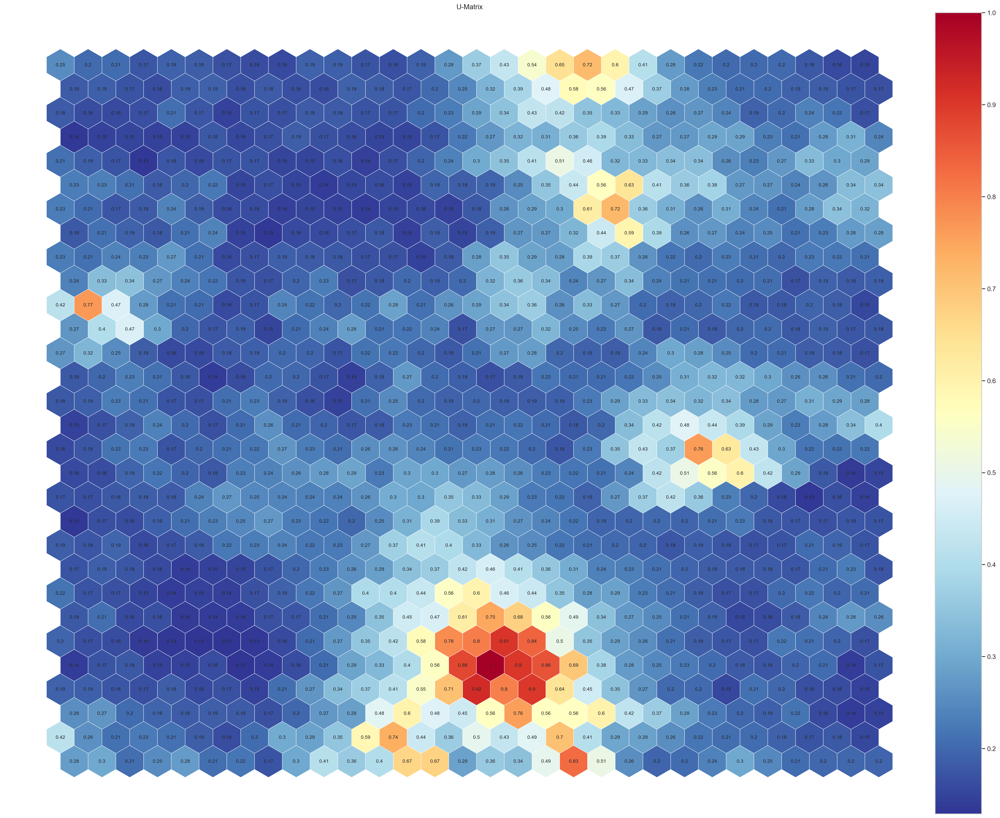

In [603]:
# Compute U-Matrix
umat = sm.distance_map(scaling='mean')  # Compute the U-Matrix

# Create figure
fig = plt.figure(figsize=(30, 30))

# Normalize the color range based on U-Matrix values
colornorm = mpl_colors.Normalize(vmin=np.min(umat), vmax=np.max(umat))

# Use the plot_hexagons function (correcting the Colorbar issue)
fig = plot_hexagons(
    som=sm,
    sf=fig,
    colornorm=colornorm,
    matrix_vals=umat,
    label="U-Matrix",
    cmap=plt.cm.RdYlBu_r,
    annot=True  # Correct colormap
)

<hr>

<a class="anchor">

### HITS Matrix

In the HITS Matrix visualization we get the distribution of the data points across the nodes of the Self-Organizing Map (SOM). Each hexagonal cell represents a SOM node, and the intensity of the color indicates the number of data points (or "hits") mapped to that node.

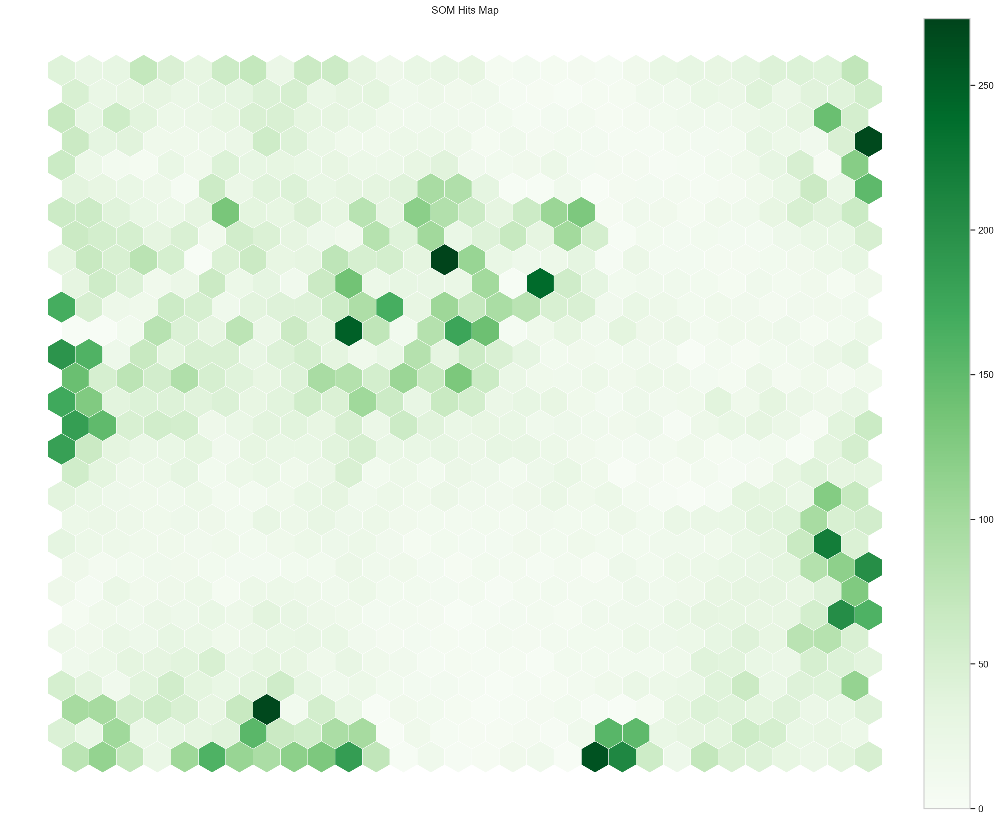

In [604]:
hitsmatrix = sm.activation_response(metric_features_scaled.values)

fig = plt.figure(figsize=(20,20))

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens,
                    )

<hr>

<a class="anchor">

### Singular Hexagons For Metric Feature

In [605]:
# Ensure metric_features_scaled is a DataFrame
if isinstance(metric_features_scaled, np.ndarray):
    metric_features_scaled = pd.DataFrame(metric_features_scaled)

weights = sm.get_weights()  # Get SOM weights

# Determine the number of features and subfigure grid size
n_features = weights.shape[2]
n_cols = 4  # Number of columns in the subfigure grid
n_rows = (n_features // n_cols) + (1 if n_features % n_cols != 0 else 0)  # Calculate rows dynamically

# Create the figure and subfigures
fig = plt.figure(figsize=(30, n_rows * 7.5), constrained_layout=True, dpi=128)
subfigs = fig.subfigures(n_rows, n_cols, wspace=0.15)

# Loop through features and create hexagonal plots
for cpi, sf in zip(range(n_features), subfigs.flatten()):
    matrix_vals = weights[:, :, cpi]  # Extract weights for the current feature

    # Normalize colormap for the feature's weight range
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))

    # Use feature name if metric_features_scaled is a DataFrame
    feature_label = metric_features_scaled.columns[cpi] if isinstance(metric_features_scaled, pd.DataFrame) else f"Feature {cpi + 1}"

    # Plot using the custom plot_hexagons function
    sf = plot_hexagons(
        som=sm,
        sf=sf,
        colornorm=colornorm,
        matrix_vals=matrix_vals,
        label=feature_label,
        cmap=cm.coolwarm,
    )

# If there are unused subplots, hide them
for sf in subfigs.flatten()[n_features:]:
    for ax in sf.axes:  # Access Axes within SubFigure
        ax.axis("off")  # Turn off the axis for unused Axes

This visualization represents individual heatmaps for each metric feature mapped to the nodes of the Self-Organizing Map (SOM). Each feature's heatmap highlights its distribution and behavior across the SOM grid, allowing for a detailed examination of feature-specific patterns.

Darker red areas highlight regions of the SOM where the feature values are higher, indicating potential clusters of nodes with similar feature behavior.

<hr>

<a class="anchor">

## 3.2. Perspectives

In [606]:
value_features = [
    'total_money_spent',
    # 'Log_Total_Money_Spent',
    'avg_spent_per_product',
    # 'Log_avg_spent_per_product',
    # 'customer_frequency',
    # 'customer_time'
    # 'Log_customer_time'
]

preference_features = [
    'orders_from_chain',
    # 'Log_orders_from_chain',
    # 'total_orders',
    # 'Log_Total_Orders',
    # 'avg_products_per_order',
    # 'vendor_count',
    # 'product_count',

    # 'Proportion peak_hours',
    # 'Proportion off_peak_hours',
    # 'off_peak_hours',

    # 'different_CUI', 

    'proportion_CUI_popular_asian',
    'proportion_CUI_asian',
    'proportion_CUI_western',
    "proportion_CUI_other_cuisines",
    "proportion_CUI_Street Food / Snacks"

    # 'CUI_Popular_Asian',
    # 'CUI_Asian',
    # 'CUI_Western',
    # "CUI_Other_Cuisines",
    # "CUI_Street Food / Snacks",
]

In [607]:
perspective_features = list(set(value_features + preference_features))

In [608]:
df_value = metric_features_scaled[value_features]
df_prf = metric_features_scaled[preference_features]

<a class="anchor">

## 3.3. Outliers 

<a class="anchor">

### 3.3.1. DBScan

DBSCAN groups points into clusters based on density, where points in dense regions are assigned to the same cluster.

Defining EPS:
The K-Distance Graph helps identify a "elbow" point in the curve, which is the optimal eps value.

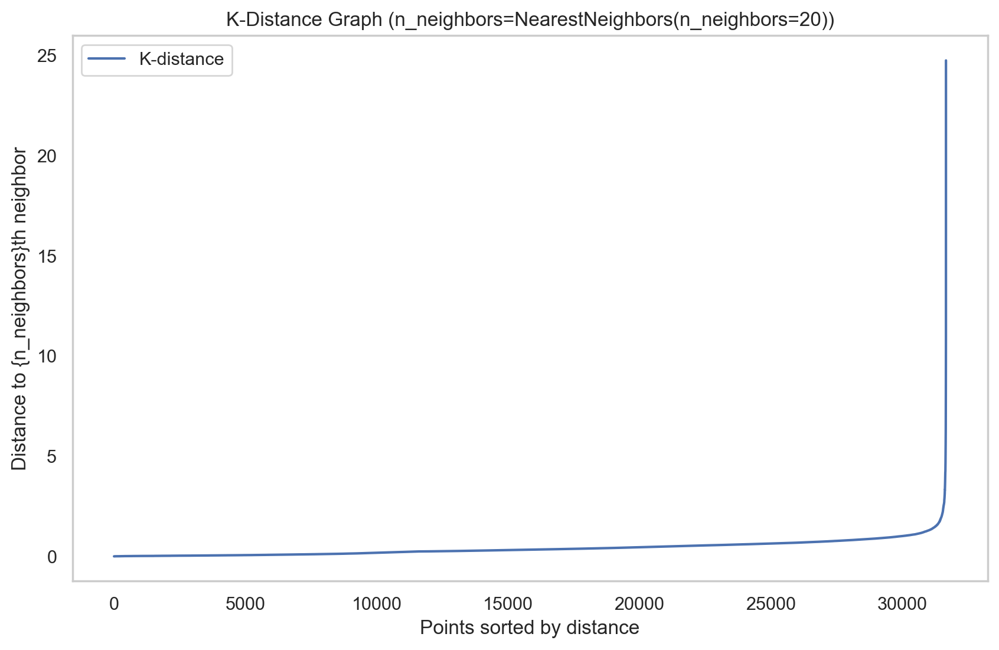

In [609]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(metric_features_scaled[perspective_features])
distances, _ = neigh.kneighbors(metric_features_scaled[perspective_features])
# Sort the distances to plot the k-distance curve
distances = np.sort(distances[:, -1])
plt.figure(figsize=(10, 6))
plt.plot(distances, label="K-distance")
plt.title(f"K-Distance Graph (n_neighbors={neigh})")
plt.xlabel("Points sorted by distance")
plt.ylabel("Distance to {n_neighbors}th neighbor")
plt.legend()
plt.grid()
plt.show()

Conclusion: eps=2.5

In [610]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=2.5, min_samples=20)
dbscan_labels = dbscan.fit_predict(metric_features_scaled[perspective_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


Outlier Identification and Removal: Points that do not meet the density criteria are classified as outliers (-1 cluster label).

In [611]:
# Concatenating the labels to df
df_concat = pd.concat([metric_features_scaled[perspective_features], pd.Series(dbscan_labels, index=metric_features_scaled[perspective_features].index, name="dbscan_labels")], axis=1)

# Detecting noise (potential outliers)
# df_concat.loc[df_concat['dbscan_labels'] == -1]
df_out = df_concat.loc[df_concat['dbscan_labels'] == -1]
df_out

,proportion_CUI_western,orders_from_chain,total_money_spent,proportion_CUI_Street Food / Snacks,proportion_CUI_other_cuisines,proportion_CUI_popular_asian,proportion_CUI_asian,avg_spent_per_product,dbscan_labels
customer_id,,,,,,,,,
249ba584d3,-0.676331,1.297409,18.718218,-0.324145,-0.720063,-0.675067,2.337134,0.489206,-1
0077c28499,-0.542964,3.556387,12.542837,0.676432,-0.329445,0.208730,0.278649,0.525553,-1
6f7904b7dd,-0.195408,15.604266,4.981752,-0.324145,0.647985,0.342728,-0.614360,-1.075831,-1
7d989d40a2,-0.682883,-0.710570,8.551080,-0.324145,-0.748577,2.332624,-0.620685,-0.507966,-1
733ef62d70,0.333388,10.584316,6.364872,-0.324145,0.330816,-0.630146,0.136345,-0.447299,-1
79db33bf39,-0.566659,11.086311,6.288654,-0.264365,-0.360288,1.330303,-0.189287,-0.885862,-1
89b7866691,-0.409606,17.612246,6.982152,-0.307081,1.531326,-0.369382,-0.620685,-1.054790,-1
910e70571d,0.362285,5.815364,11.839220,-0.324145,0.572313,-0.228637,-0.547189,-0.627793,-1
92ced2dcb9,-0.603485,19.620226,29.708898,-0.282717,-0.415841,1.723867,-0.472869,-0.567626,-1


In [612]:
### CLEANED DATAFRAME FROM OUTLIERS USING DBSCAN:
dbscan_metric_features_scaled = df_concat[df_concat['dbscan_labels'] != -1]

# Drop the 'dbscan_labels' column if it's no longer needed
dbscan_metric_features_scaled = dbscan_metric_features_scaled.drop(columns=['dbscan_labels'])

percent_removed = (metric_features_scaled.shape[0] - dbscan_metric_features_scaled.shape[0]) / metric_features_scaled.shape[0] * 100

# Check the result
print('Original df rows:', df.shape[0])
print("Rows before removing outliers:", metric_features_scaled.shape[0])
print("Rows after removing outliers with DBScan:", dbscan_metric_features_scaled.shape[0])
print(f"Percentage of rows removed: {percent_removed:.2f}%")

Original df rows: 31888
Rows before removing outliers: 31672
Rows after removing outliers with DBScan: 31632
Percentage of rows removed: 0.13%


In [613]:
dbscan_value = dbscan_metric_features_scaled[value_features]
dbscan_preference = dbscan_metric_features_scaled[preference_features]

<a class="anchor">

### 3.3.2. DBScan + Manual

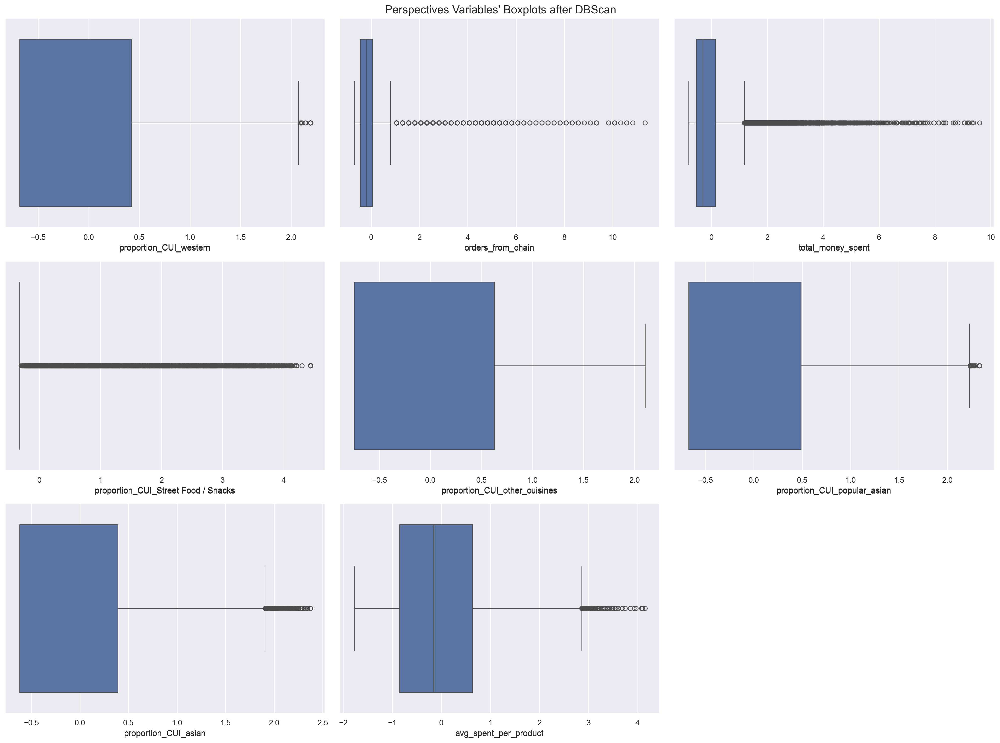

In [614]:
# Adjusted code to plot all numeric features' boxplots
sns.set()

# Prepare figure. Create individual axes where each boxplot will be placed
num_features = len(dbscan_metric_features_scaled.columns)
rows = ceil(num_features / 3)  # Adjust the number of rows based on total features
fig, axes = plt.subplots(rows, 3, figsize=(20, 5 * rows))

# Flatten axes for easy iteration
axes = axes.flatten()

# Plot data
for ax, feat in zip(axes, dbscan_metric_features_scaled.columns):
    sns.boxplot(x=dbscan_metric_features_scaled[feat].dropna(), ax=ax)
    ax.set_title(feat, y=-0.13)

# Hide any unused subplots
for ax in axes[len(dbscan_metric_features_scaled.columns):]:
    ax.axis('off')  

# Layout
# Add a centered title to the figure:
title = "Perspectives Variables' Boxplots after DBScan"
plt.suptitle(title, fontsize=16)

plt.tight_layout()
plt.show()

In [615]:
outlier_conditions = (
    (dbscan_metric_features_scaled["total_money_spent"] <= 8) &
    (dbscan_metric_features_scaled["avg_spent_per_product"] <= 4) &
    # (dbscan_metric_features_scaled["customer_frequency"] <= 0.35) &
    (dbscan_metric_features_scaled["orders_from_chain"] <= 9.5) &
    # (dbscan_metric_features_scaled["total_orders"] <= 8) &
    (dbscan_metric_features_scaled["orders_from_chain"] <= 10) &
    # (dbscan_metric_features_scaled["vendor_count"] <= 0.8) &
    # (dbscan_metric_features_scaled["product_count"] <= 0.35) &
    (dbscan_metric_features_scaled["proportion_CUI_Street Food / Snacks"] <= 4.3)
    # (dbscan_metric_features_scaled["Proportion CUI_Western"] <= 0.95) &
    # (dbscan_metric_features_scaled["Proportion peak_hours"] <= 1) &
    # (dbscan_metric_features_scaled["Proportion off_peak_hours"] <= 1) &
    # (dbscan_metric_features_scaled["different_CUI"] <= 0.70) &
    # (dbscan_metric_features_scaled["Proportion CUI_Other_Cuisines"] <= 1) &
    # (dbscan_metric_features_scaled["Proportion CUI_Asian"] <= 1) &
    # (dbscan_metric_features_scaled["Proportion CUI_Popular Asian"] <= 1) 
    # (dbscan_metric_features_scaled["CUI_Popular_Asian"] <= 10) &
    # (dbscan_metric_features_scaled["CUI_Asian"] <= 10) &
    # (dbscan_metric_features_scaled["peak_hours"] <= 0.4) &
    # (dbscan_metric_features_scaled["CUI_Western"] <= 12)
)

# Filter the DataFrame with DBScan and manual
dbscan_manual_metric_features_scaled = dbscan_metric_features_scaled[outlier_conditions]

# Check the shape before and after filtering with DBScan and manual
print("Rows before removing outliers:", metric_features_scaled.shape[0])
print("Rows after removing outliers with DBScan + Manual:", dbscan_manual_metric_features_scaled.shape[0])

# Calculate percentual difference in rows
rows_before = metric_features_scaled.shape[0]
rows_after = dbscan_manual_metric_features_scaled.shape[0]
percentual_difference = ((rows_before - rows_after) / rows_before) * 100

# Display the percentual difference
print(f"Percentual difference in rows: {percentual_difference:.2f}%")

Rows before removing outliers: 31672
Rows after removing outliers with DBScan + Manual: 30796
Percentual difference in rows: 2.77%


Boxplots after removing outliers with DBScan + Manual:

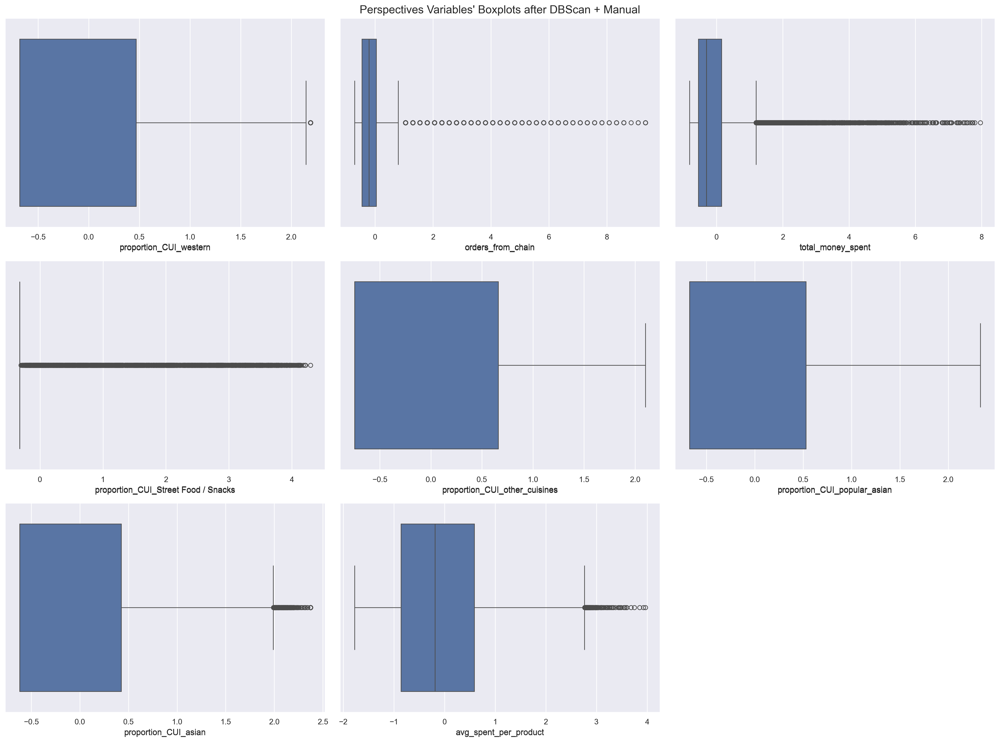

In [616]:
# Adjusted code to plot all numeric features' boxplots
sns.set()

# Prepare figure. Create individual axes where each boxplot will be placed
num_features = len(dbscan_manual_metric_features_scaled.columns)
rows = ceil(num_features / 3)  # Adjust the number of rows based on total features
fig, axes = plt.subplots(rows, 3, figsize=(20, 5 * rows))

# Flatten axes for easy iteration
axes = axes.flatten()

# Plot data
for ax, feat in zip(axes, dbscan_manual_metric_features_scaled.columns):
    sns.boxplot(x=dbscan_manual_metric_features_scaled[feat].dropna(), ax=ax)
    ax.set_title(feat, y=-0.13)

# Hide any unused subplots
for ax in axes[len(dbscan_manual_metric_features_scaled.columns):]:
    ax.axis('off')

# Layout
# Add a centered title to the figure:
title = "Perspectives Variables' Boxplots after DBScan + Manual"
plt.suptitle(title, fontsize=16)

plt.tight_layout()
plt.show()

In [617]:
dbscan_plus_manual_value = dbscan_manual_metric_features_scaled[value_features]
dbscan_plus_manual_preference = dbscan_manual_metric_features_scaled[preference_features]

<a class="anchor">

### 3.3.3. 99% Quantile 

In [618]:
# Calculate the 0.99 quantile thresholds for the selected features
thresholds = metric_features_scaled[perspective_features].quantile(0.99)

# Create a mask to identify rows within the thresholds
mask = (metric_features_scaled[perspective_features] <= thresholds).all(axis=1)

quantile_metric_features_scaled = metric_features_scaled[mask]

quantile99_value = quantile_metric_features_scaled[value_features]
quantile99_preference = quantile_metric_features_scaled[preference_features]
quantile99_perspetives = quantile_metric_features_scaled[perspective_features]

# Calculate percentual difference in rows
rows_before = metric_features_scaled.shape[0]
rows_after = quantile_metric_features_scaled.shape[0]
percentual_difference = ((rows_before - rows_after) / rows_before) * 100

# Display the shapes
print("Rows before removing outliers:", metric_features_scaled.shape[0])
print("Rows after removing outliers based on 0.99 quantile:", quantile_metric_features_scaled.shape[0])
print(f"Percentual difference in rows: {percentual_difference:.2f}%")


Rows before removing outliers: 31672
Rows after removing outliers based on 0.99 quantile: 30820
Percentual difference in rows: 2.69%


Boxplots after removing outliers based on quantile 99:

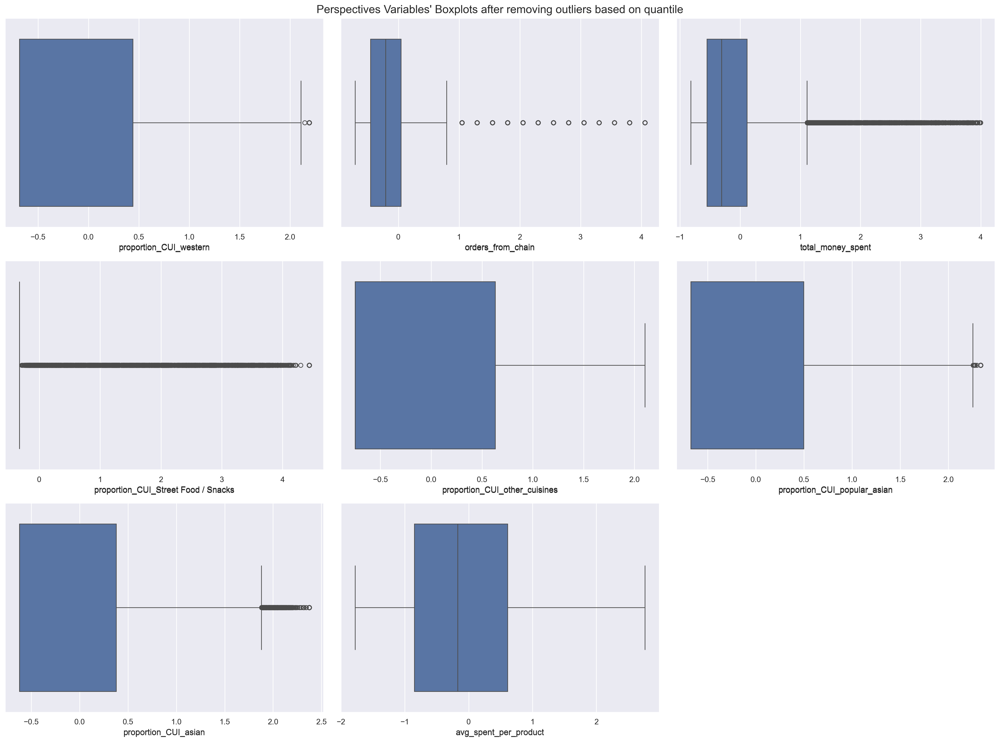

In [619]:
# Adjusted code to plot all numeric features' boxplots
sns.set()

# Prepare figure. Create individual axes where each boxplot will be placed
num_features = len(quantile99_perspetives.columns)
rows = ceil(num_features / 3)  # Adjust the number of rows based on total features
fig, axes = plt.subplots(rows, 3, figsize=(20, 5 * rows))

# Flatten axes for easy iteration
axes = axes.flatten()

# Plot data
for ax, feat in zip(axes, quantile99_perspetives.columns):
    sns.boxplot(x=quantile99_perspetives[feat].dropna(), ax=ax)
    ax.set_title(feat, y=-0.13)

# Hide any unused subplots
for ax in axes[len(quantile99_perspetives.columns):]:
    ax.axis('off')

# Layout
# Add a centered title to the figure:
title = "Perspectives Variables' Boxplots after removing outliers based on quantile"
plt.suptitle(title, fontsize=16)

plt.tight_layout()
plt.show()

<a class="anchor">

### 3.3.4. Methods Comparison

In [620]:
# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    metric='euclidean'
)

In [621]:
# Functions from Lab 09
def get_ss(df, feats):
    """
    Calculate the sum of squares (SS) for the given DataFrame.

    The sum of squares is computed as the sum of the variances of each column
    multiplied by the number of non-NA/null observations minus one.

    Parameters:
    df (pandas.DataFrame): The input DataFrame for which the sum of squares is to be calculated.
    feats (list of str): A list of feature column names to be used in the calculation.

    Returns:
    float: The sum of squares of the DataFrame.
    """
    df_ = df[feats]
    ss = np.sum(df_.var() * (df_.count() - 1))
    
    return ss 


def get_ssb(df, feats, label_col):
    """
    Calculate the between-group sum of squares (SSB) for the given DataFrame.
    The between-group sum of squares is computed as the sum of the squared differences
    between the mean of each group and the overall mean, weighted by the number of observations
    in each group.

    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the data.
    feats (list of str): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column in the DataFrame that contains the group labels.
    
    Returns
    float: The between-group sum of squares of the DataFrame.
    """
    
    ssb_i = 0
    for i in np.unique(df[label_col]):
        df_ = df.loc[:, feats]
        X_ = df_.values
        X_k = df_.loc[df[label_col] == i].values
        
        ssb_i += (X_k.shape[0] * (np.square(X_k.mean(axis=0) - X_.mean(axis=0))) )

    ssb = np.sum(ssb_i)
    

    return ssb


def get_ssw(df, feats, label_col):
    """
    Calculate the sum of squared within-cluster distances (SSW) for a given DataFrame.

    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the data.
    feats (list of str): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing cluster labels.

    Returns:
    float: The sum of squared within-cluster distances (SSW).
    """
    feats_label = feats+[label_col]

    df_k = df[feats_label].groupby(by=label_col).apply(lambda col: get_ss(col, feats), 
                                                       include_groups=False)

    return df_k.sum()

In [622]:
# Functions from Lab 09
 
def get_rsq(df, feats, label_col):
    """
    Calculate the R-squared value for a given DataFrame and features.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing the data.
    feats (list): A list of feature column names to be used in the calculation.
    label_col (str): The name of the column containing the labels or cluster assignments.

    Returns:
    float: The R-squared value, representing the proportion of variance explained by the clustering.
    """

    df_sst_ = get_ss(df, feats)                 # get total sum of squares
    df_ssw_ = get_ssw(df, feats, label_col)     # get ss within
    df_ssb_ = df_sst_ - df_ssw_                 # get ss between

    # r2 = ssb/sst 
    return (df_ssb_/df_sst_)

In [623]:
def get_r2_scores(df, feats, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        df_concat = pd.concat([df, 
                               pd.Series(labels, name='labels', index=df.index)], axis=1)  

        r2_clust[n] = get_rsq(df_concat, feats, 'labels' )
    return r2_clust

In [624]:
r2_scores = {}

r2_scores['DBScan'] = get_r2_scores(dbscan_value, value_features, kmeans)
r2_scores['DBScan + Manual'] = get_r2_scores(dbscan_plus_manual_value, value_features, kmeans)
r2_scores['Quantile 0.99'] = get_r2_scores(quantile99_value, value_features, kmeans)
r2_scores['Original DataFrame'] = get_r2_scores(df_value, value_features, kmeans)

In [625]:
r2_scores_df = pd.DataFrame(r2_scores)
r2_scores_df

,DBScan,DBScan + Manual,Quantile 0.99,Original DataFrame
2,0.417644,0.420348,0.482891,0.391707
3,0.646552,0.650257,0.668221,0.625468
4,0.735173,0.736911,0.762795,0.709726
5,0.794165,0.794620,0.801446,0.778694
6,0.829834,0.830056,0.839483,0.811771
7,0.857064,0.857373,0.866094,0.842213
8,0.877726,0.877533,0.886095,0.865484
9,0.894674,0.894993,0.898822,0.881627


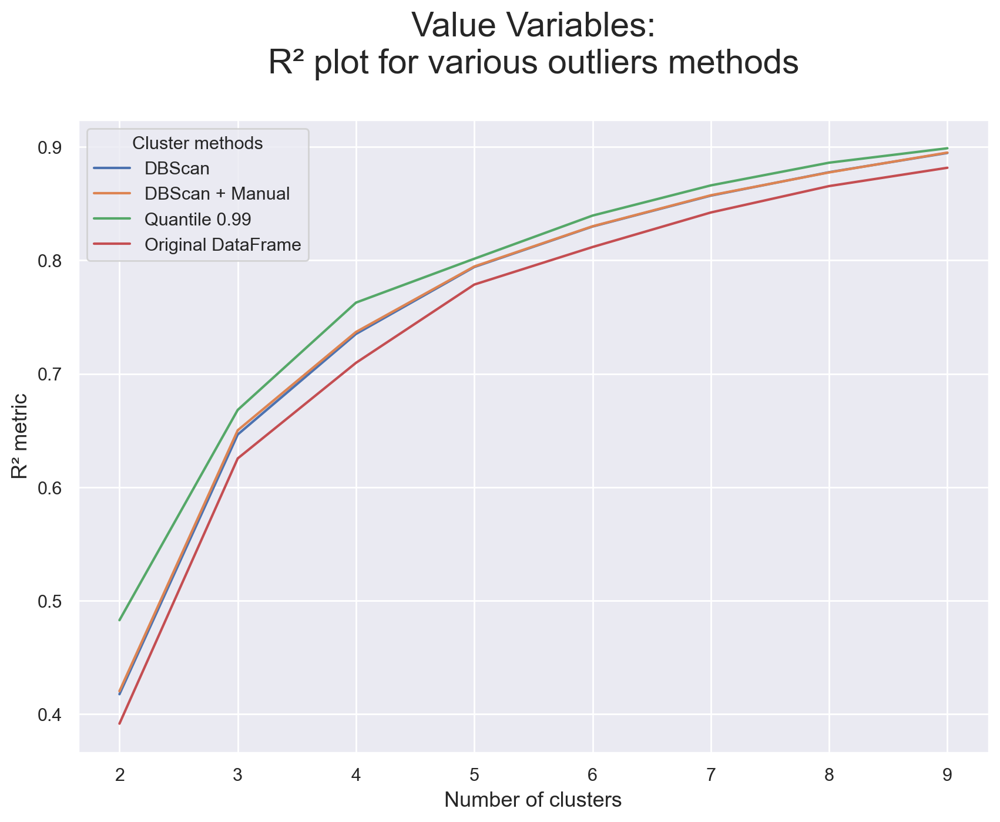

In [626]:
# Visualizing the R² scores for each cluster solution on value variables
r2_scores_df.plot.line(figsize=(10,7))

plt.title("Value Variables:\nR² plot for various outliers methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

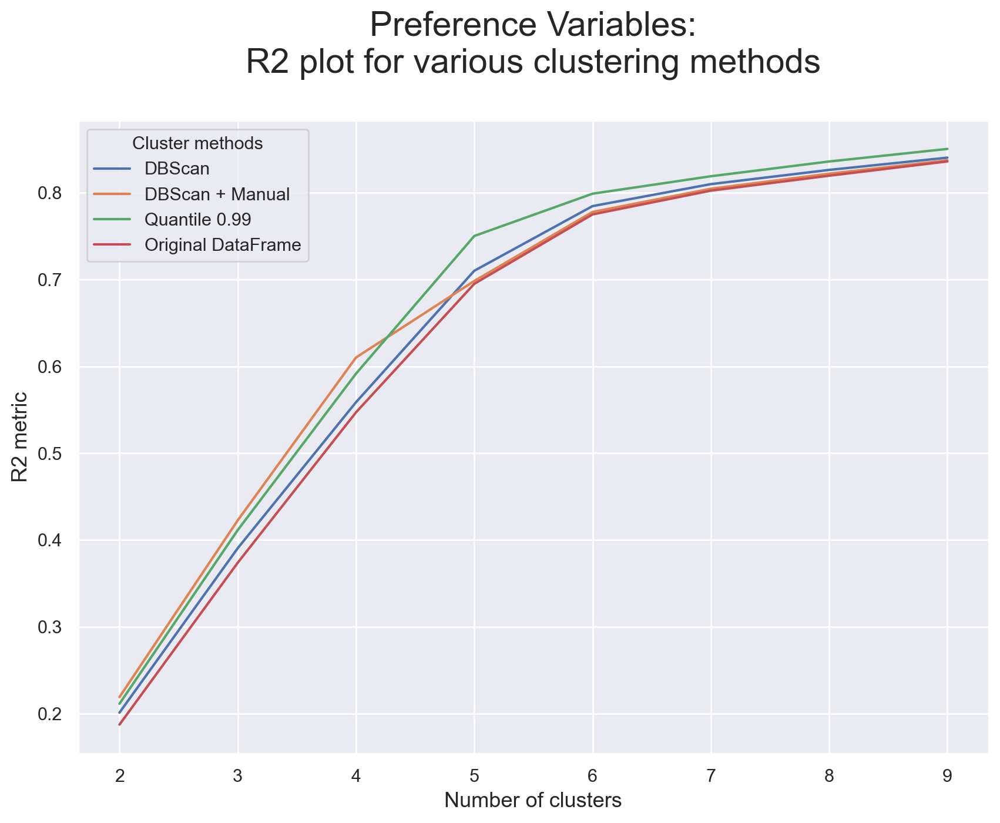

In [627]:
# Obtaining the R² scores for each cluster solution on preference variables
r2_scores_pref = {}
r2_scores_pref['DBScan'] = get_r2_scores(dbscan_preference, preference_features, kmeans)
r2_scores_pref['DBScan + Manual'] = get_r2_scores(dbscan_plus_manual_preference, preference_features, kmeans)
r2_scores_pref['Quantile 0.99'] = get_r2_scores(quantile99_preference, preference_features, kmeans)
r2_scores_pref['Original DataFrame'] = get_r2_scores(df_prf, preference_features, kmeans)

# Visualizing the R² scores for each cluster solution on product variables
pd.DataFrame(r2_scores_pref).plot.line(figsize=(10,7))

plt.title("Preference Variables:\nR2 plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
plt.show()

CONCLUSION: We will keep the DBScan outlier removal method since we consider to be the best tradeoff.

#### Defining the final outlier removal method

In [628]:
value_perspective = dbscan_value.copy()
preference_perspective = dbscan_preference.copy()

<a class="anchor">

## 3.4. SOM - Value Perspective Features

In [629]:
def plot_hexagons(som,              # Trained SOM model 
                  sf,               # matplotlib figure object
                  colornorm,        # colornorm
                  matrix_vals,      # SOM weights or
                  label="",         # title for figure
                  cmap=cm.Grays,    # colormap to use
                  annot=False       
                  ):

    
    axs = sf.subplots(1,1)
    
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):

            wx, wy = som.convert_map_to_euclidean((i,j)) 

            hex = RegularPolygon((wx, wy), 
                                numVertices=6, 
                                radius= np.sqrt(1/3),
                                facecolor=cmap(colornorm(matrix_vals[i, j])), 
                                alpha=1, 
                                edgecolor='white',
                                linewidth=.5)
            axs.add_patch(hex)
            if annot==True:
                annot_val = np.round(matrix_vals[i,j],2)
                if int(annot_val) == annot_val:
                    annot_val = int(annot_val)
                axs.text(wx,wy, annot_val, 
                        ha='center', va='center', 
                        fontsize='x-small')

    ## Remove axes for hex plot
    axs.margins(.05)
    axs.set_aspect('equal')
    axs.axis("off")
    axs.set_title(label)

    # ## Add colorbar
    divider = make_axes_locatable(axs)
    ax_cb = divider.append_axes("right", size="5%", pad="0%")

    ## Create a Mappable object
    cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    cmap_sm.set_array([])

    ## Create custom colorbar 
    cb1 = colorbar.Colorbar(ax_cb,
                            orientation='vertical', 
                            alpha=1,
                            mappable=cmap_sm
                            )
    cb1.ax.get_yaxis().labelpad = 6

    # Add colorbar to plot
    sf.add_axes(ax_cb)

    return sf 

In [630]:
# SOM Configuration
M = 20  # SOM grid rows
N = 20  # SOM grid columns
neighborhood_function = 'gaussian'  # Neighborhood function
topology = 'hexagonal'  # SOM grid topology
learning_rate = 0.2  # Initial learning rate

# Convert data to numpy array
som_data = np.array(value_perspective)
n_feats = som_data.shape[1]  # Number of features in the data

# Initialize SOM
sm = MiniSom(
    x=M, y=N,                  # 20x20 map size
    input_len=n_feats,         # Number of input features
    learning_rate=learning_rate,
    topology=topology,
    neighborhood_function=neighborhood_function,
    activation_distance='euclidean',
    random_seed=42             # For reproducibility
)

# Initialize weights with random samples from data
sm.random_weights_init(som_data)

# Print initial Quantization and Topographic Errors
print("Before training:")
print("Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
print("Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))

# Training Configuration
n_phases = 10  # Increase the number of phases for more gradual convergence
iterations_per_phase = 10000  # Reduce iterations per phase for more frequent adjustments

# Training loop with dynamically adjusted parameters
for phase in range(n_phases):
    print(f"\nPhase {phase + 1}/{n_phases}")
    
    # Dynamically adjust learning rate and neighborhood radius
    sm.learning_rate = learning_rate * (1 - (phase / n_phases))
    sm.sigma = max(M, N) / 2 * (1 - (phase / n_phases))  # Start with large radius and reduce over time
    
    # Train SOM
    sm.train_batch(som_data, iterations_per_phase)
    
    # Print updated Quantization and Topographic Errors
    print("Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
    print("Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))

# Final training results
print("\nAfter training:")
print("Final Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
print("Final Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))



Before training:
Quantization Error (QE): 0.0701
Topographic Error (TE): 0.9869

Phase 1/10
Quantization Error (QE): 0.0747
Topographic Error (TE): 0.5002

Phase 2/10
Quantization Error (QE): 0.0662
Topographic Error (TE): 0.3911

Phase 3/10
Quantization Error (QE): 0.0626
Topographic Error (TE): 0.3434

Phase 4/10
Quantization Error (QE): 0.0599
Topographic Error (TE): 0.3034

Phase 5/10
Quantization Error (QE): 0.0597
Topographic Error (TE): 0.2824

Phase 6/10
Quantization Error (QE): 0.0582
Topographic Error (TE): 0.2907

Phase 7/10
Quantization Error (QE): 0.058
Topographic Error (TE): 0.2066

Phase 8/10
Quantization Error (QE): 0.0566
Topographic Error (TE): 0.1797

Phase 9/10
Quantization Error (QE): 0.0576
Topographic Error (TE): 0.166

Phase 10/10
Quantization Error (QE): 0.0591
Topographic Error (TE): 0.1648

After training:
Final Quantization Error (QE): 0.0591
Final Topographic Error (TE): 0.1648


<a class="anchor">

### U-Matrix Standard Scaler SOM

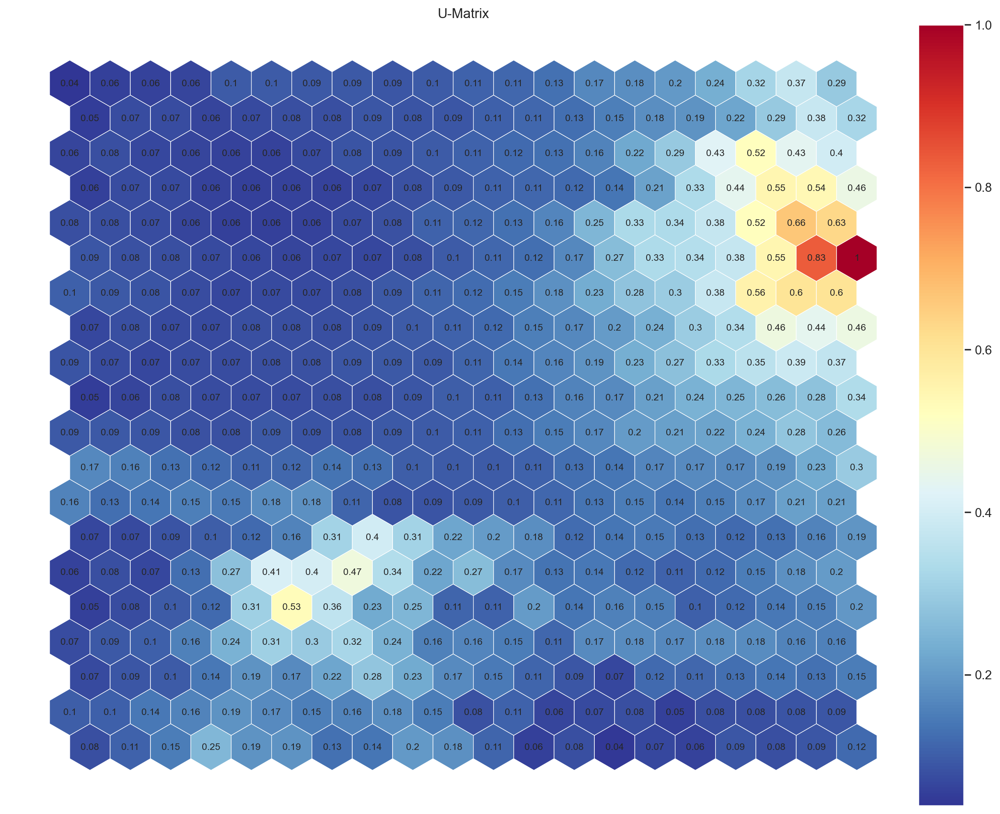

In [631]:
# Compute U-Matrix
umat = sm.distance_map(scaling='mean')  # Compute the U-Matrix

# Create figure
fig = plt.figure(figsize=(15, 15))

# Normalize the color range based on U-Matrix values
colornorm = mpl_colors.Normalize(vmin=np.min(umat), vmax=np.max(umat))

# Use the plot_hexagons function (correcting the Colorbar issue)
fig = plot_hexagons(
    som=sm,
    sf=fig,
    colornorm=colornorm,
    matrix_vals=umat,
    label="U-Matrix",
    cmap=plt.cm.RdYlBu_r,
    annot=True  # Correct colormap
)

<a class="anchor">

### Singular Hexagons For Value Features

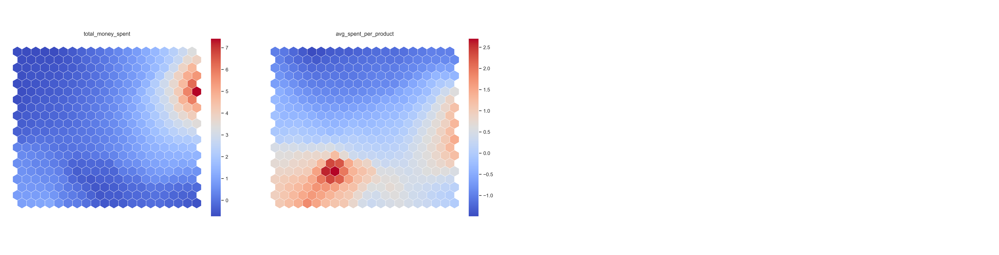

In [632]:
weights = sm.get_weights()  # Get SOM weights

# Determine the number of features and subfigure grid size
n_features = weights.shape[2]
n_cols = 4  # Number of columns in the subfigure grid
n_rows = (n_features // n_cols) + (1 if n_features % n_cols != 0 else 0)  # Calculate rows dynamically

# Create the figure and subfigures
fig = plt.figure(figsize=(30, n_rows * 7.5), constrained_layout=True, dpi=128)
subfigs = fig.subfigures(n_rows, n_cols, wspace=0.15)

# Loop through features and create hexagonal plots
for cpi, sf in zip(range(n_features), subfigs.flatten()):
    matrix_vals = weights[:, :, cpi]  # Extract weights for the current feature

    # Normalize colormap for the feature's weight range
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))

    # Use feature name if metric_features_scaled is a DataFrame
    feature_label = value_perspective.columns[cpi] if isinstance(value_perspective, pd.DataFrame) else f"Feature {cpi + 1}"

    # Plot using the custom plot_hexagons function
    sf = plot_hexagons(
        som=sm,
        sf=sf,
        colornorm=colornorm,
        matrix_vals=matrix_vals,
        label=feature_label,
        cmap=cm.coolwarm,
    )

# If there are unused subplots, hide them
for sf in subfigs.flatten()[n_features:]:
    for ax in sf.axes:  # Access Axes within SubFigure
        ax.axis("off")  # Turn off the axis for unused Axes

<a class="anchor">

## 3.5. SOM - Preference Perspective

In [633]:
# SOM Configuration
M = 20  # Map size rows
N = 20  # Map size columns
neighborhood_function = 'gaussian'  # Neighborhood function
topology = 'hexagonal'  # Topology of SOM grid
learning_rate = 0.2  # Initial learning rate

# Convert data to numpy array
som_data = np.array(preference_perspective)
n_feats = som_data.shape[1]  # Number of features in the data

# Initialize SOM
sm = MiniSom(
    x=M, y=N,              # 20x20 map size
    input_len=n_feats,     # Number of input features
    learning_rate=learning_rate,
    topology=topology,
    neighborhood_function=neighborhood_function,
    activation_distance='euclidean',  # Distance metric
    random_seed=42                  # For reproducibility
)

# Initialize weights with random samples from data
sm.random_weights_init(som_data)

# Print initial Quantization and Topographic Errors
print("Before training:")
print("Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
print("Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))

# Training Configuration
n_phases = 10  # Number of training phases
iterations_per_phase = 10000  # Iterations per phase

# Training loop with progressively decreasing learning rate and neighborhood radius
for phase in range(n_phases):
    print(f"\nPhase {phase + 1}/{n_phases}")
    
    # Dynamically adjust learning rate and neighborhood radius
    sm.learning_rate = learning_rate * (1 - (phase / n_phases))
    sm.sigma = max(M, N) / 2 * (1 - (phase / n_phases))  # Start with large radius and reduce over phases
    
    # Train SOM
    sm.train_batch(som_data, iterations_per_phase)
    
    # Print updated Quantization and Topographic Errors
    print("Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
    print("Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))

# Final training results
print("\nAfter training:")
print("Final Quantization Error (QE):", np.round(sm.quantization_error(som_data), 4))
print("Final Topographic Error (TE):", np.round(sm.topographic_error(som_data), 4))



Before training:
Quantization Error (QE): 0.2378
Topographic Error (TE): 0.9925

Phase 1/10
Quantization Error (QE): 0.2289
Topographic Error (TE): 0.2469

Phase 2/10
Quantization Error (QE): 0.2186
Topographic Error (TE): 0.1987

Phase 3/10
Quantization Error (QE): 0.2164
Topographic Error (TE): 0.1856

Phase 4/10
Quantization Error (QE): 0.2153
Topographic Error (TE): 0.1717

Phase 5/10
Quantization Error (QE): 0.2147
Topographic Error (TE): 0.164

Phase 6/10
Quantization Error (QE): 0.216
Topographic Error (TE): 0.1763

Phase 7/10
Quantization Error (QE): 0.2159
Topographic Error (TE): 0.1749

Phase 8/10
Quantization Error (QE): 0.2154
Topographic Error (TE): 0.1708

Phase 9/10
Quantization Error (QE): 0.2145
Topographic Error (TE): 0.1827

Phase 10/10
Quantization Error (QE): 0.2148
Topographic Error (TE): 0.1762

After training:
Final Quantization Error (QE): 0.2148
Final Topographic Error (TE): 0.1762


<a class="anchor">

### U-Matrix Standard Scaler SOM

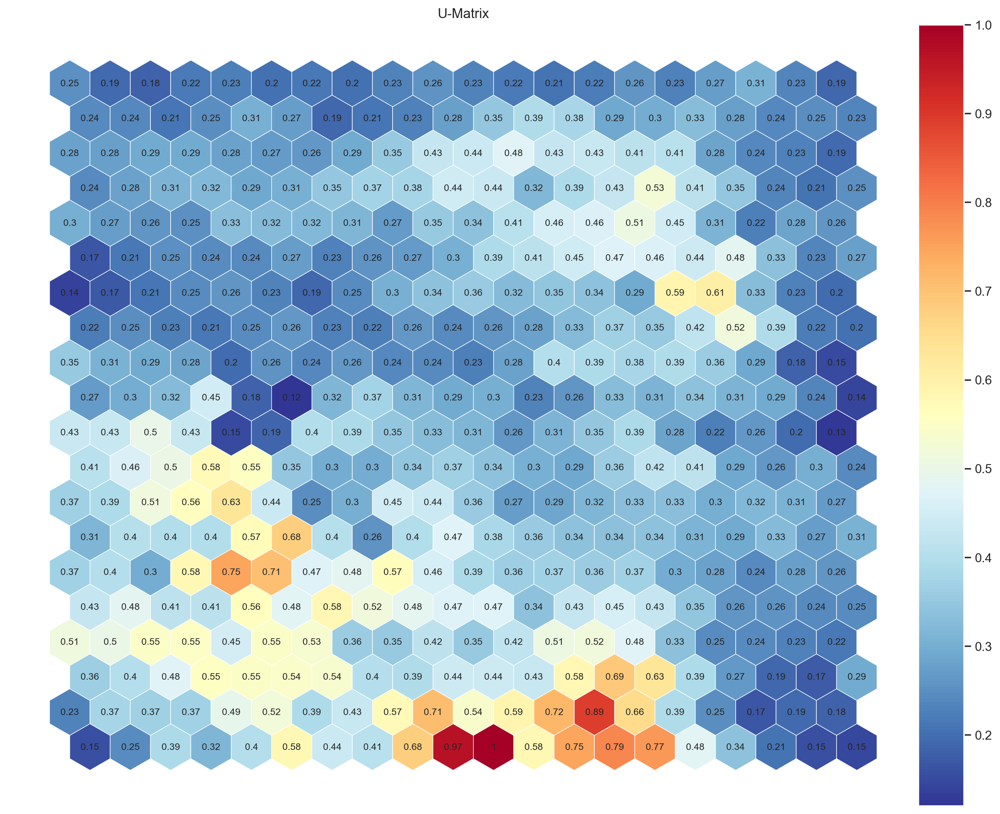

In [634]:
# Compute U-Matrix
umat = sm.distance_map(scaling='mean')  # Compute the U-Matrix

# Create figure
fig = plt.figure(figsize=(15, 15))

# Normalize the color range based on U-Matrix values
colornorm = mpl_colors.Normalize(vmin=np.min(umat), vmax=np.max(umat))

# Use the plot_hexagons function (correcting the Colorbar issue)
fig = plot_hexagons(
    som=sm,
    sf=fig,
    colornorm=colornorm,
    matrix_vals=umat,
    label="U-Matrix",
    cmap=plt.cm.RdYlBu_r,
    annot=True  # Correct colormap
)

<a class="anchor">

### Singular Hexagons For Preference Features

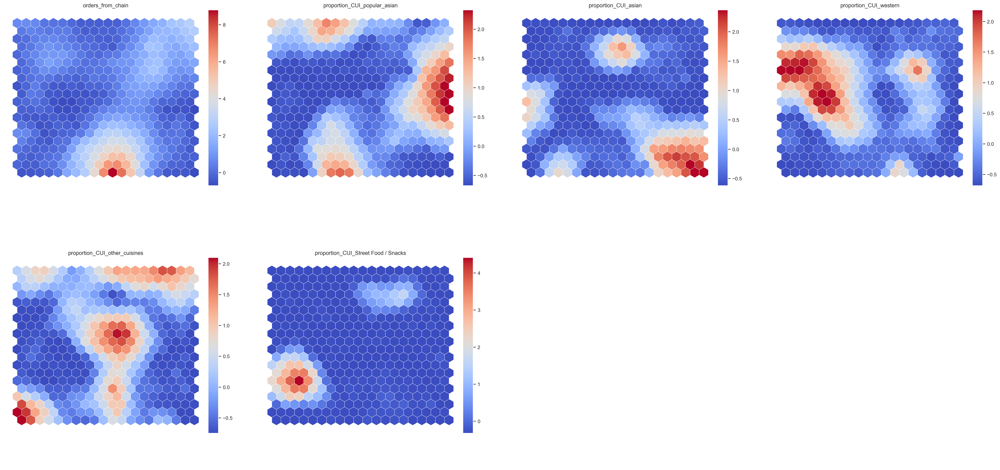

In [635]:
weights = sm.get_weights()  # Get SOM weights

# Determine the number of features and subfigure grid size
n_features = weights.shape[2]
n_cols = 4  # Number of columns in the subfigure grid
n_rows = (n_features // n_cols) + (1 if n_features % n_cols != 0 else 0)  # Calculate rows dynamically

# Create the figure and subfigures
fig = plt.figure(figsize=(30, n_rows * 7.5), constrained_layout=True, dpi=128)
subfigs = fig.subfigures(n_rows, n_cols, wspace=0.15)

# Loop through features and create hexagonal plots
for cpi, sf in zip(range(n_features), subfigs.flatten()):
    matrix_vals = weights[:, :, cpi]  # Extract weights for the current feature

    # Normalize colormap for the feature's weight range
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))

    # Use feature name if metric_features_scaled is a DataFrame
    feature_label = preference_perspective.columns[cpi] if isinstance(preference_perspective, pd.DataFrame) else f"Feature {cpi + 1}"

    # Plot using the custom plot_hexagons function
    sf = plot_hexagons(
        som=sm,
        sf=sf,
        colornorm=colornorm,
        matrix_vals=matrix_vals,
        label=feature_label,
        cmap=cm.coolwarm,
    )

# If there are unused subplots, hide them
for sf in subfigs.flatten()[n_features:]:
    for ax in sf.axes:  # Access Axes within SubFigure
        ax.axis("off")  # Turn off the axis for unused Axes

<a class="anchor">

## 3.6. Feature Selection - 2nd Part

<a class="anchor">

### Correlation Matrix - value perspective 

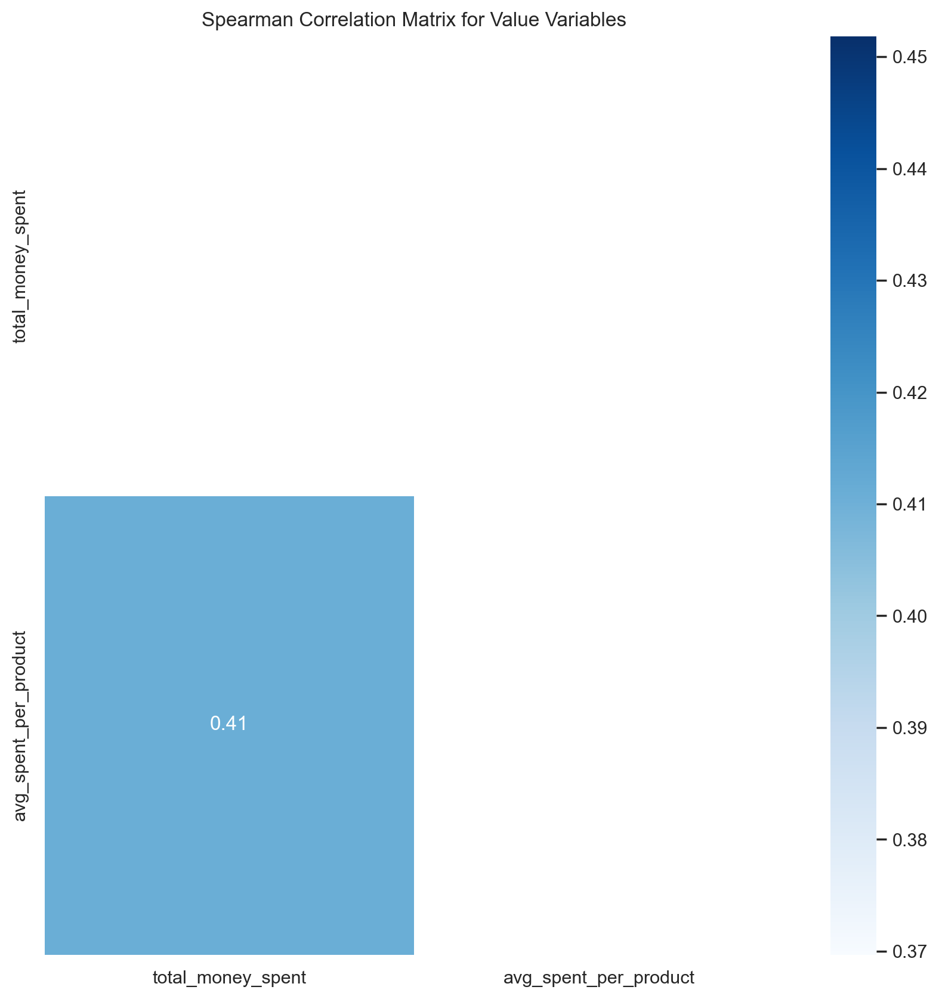

In [636]:
# correlation matrix using Spearman correlation
corr = value_perspective.corr(method="spearman")

mask = np.triu(np.ones_like(corr, dtype=bool))
sns.set_style("white")

plt.figure(figsize=(10, 10))
sns.heatmap(corr, mask=mask, annot=True, cmap='Blues', fmt=".2f", linewidths=0.2)
plt.title('Spearman Correlation Matrix for Value Variables')
plt.show()

<a class="anchor">

### Correlation Matrix - preference perspective 

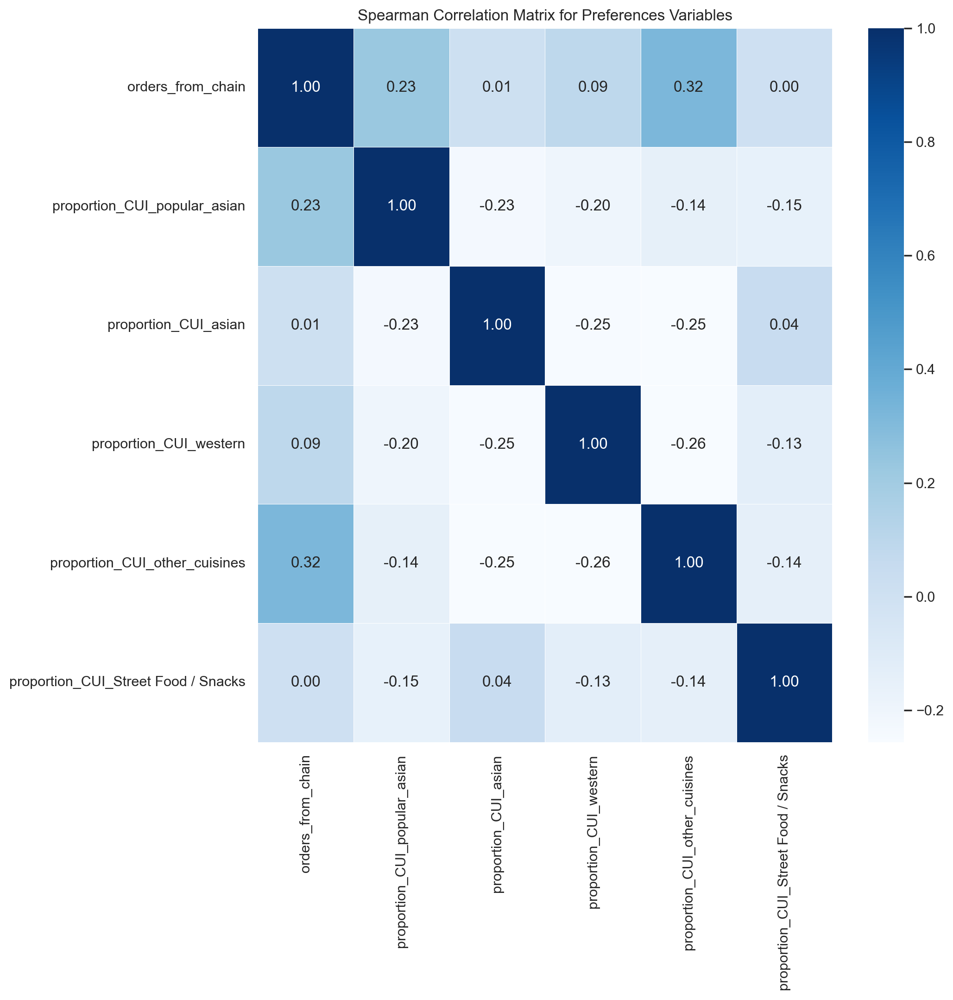

In [637]:
# correlation matrix using Spearman correlation
corr_prf = preference_perspective.corr(method="spearman")

sns.set_style("white")

plt.figure(figsize=(10, 10))
sns.heatmap(corr_prf, annot=True, cmap='Blues', fmt=".2f", linewidths=0.2)
plt.title('Spearman Correlation Matrix for Preferences Variables')
plt.show()

In [638]:
# Find pairs with correlation > 0.75
high_corr_pairs = []
for i in range(len(corr_prf.columns)):
    for j in range(i + 1, len(corr_prf.columns)):  # Start at the next column to avoid repeats
        if corr_prf.iloc[i, j] >= 0.75:  # Only consider correlations > 0.75
            high_corr_pairs.append((
                corr_prf.index[i],  # Feature 1
                corr_prf.columns[j],  # Feature 2
                corr_prf.iloc[i, j]  # Correlation value
            ))
            print(f'({corr_prf.index[i]}, {corr_prf.columns[j]}) Correlation: {corr_prf.iloc[i, j]:.2f}')

We don't have high correlated features (correlation > 0.75), therefore don't remove any.

<a class="anchor">

## 3.7. K-means and Hierarchical Clustering

In [639]:
df_value = value_perspective
df_prf = preference_perspective

<a class="anchor">

### Value Features

In [640]:
r2_scores = {}

r2_scores['kmeans'] = get_r2_scores(df_value, value_features, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_value,                 # data
        value_features,           # features of perspective
        # use HClust, changing the linkage at each iteration
        hierarchical.set_params(linkage=linkage)
    )

In [641]:
r2_scores_df = pd.DataFrame(r2_scores)
r2_scores_df

,kmeans,complete,average,single,ward
2,0.417644,0.219342,0.167222,0.002764,0.383652
3,0.646552,0.234879,0.175694,0.003736,0.584260
4,0.735173,0.573548,0.363570,0.024953,0.676235
5,0.794165,0.659345,0.682924,0.024993,0.732205
6,0.829834,0.668540,0.695619,0.027307,0.784637
7,0.857064,0.670765,0.696129,0.028448,0.831668
8,0.877726,0.712066,0.699488,0.028477,0.851943
9,0.894674,0.712743,0.734773,0.029330,0.867941


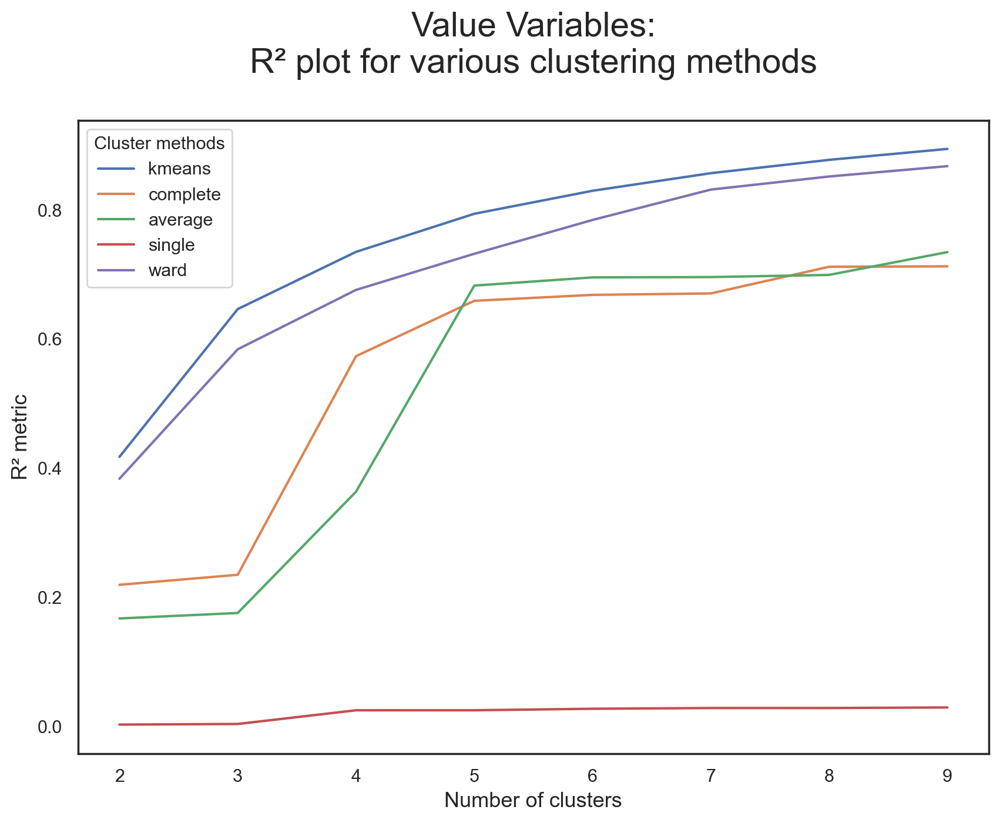

In [642]:
# Visualizing the R² scores for each cluster solution on value variables
r2_scores_df.plot.line(figsize=(10,7))

plt.title("Value Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

By analysing the elbow of the $R^2$ plot, we choose a number of clusters K=4 for the value features.

<a class="anchor">

### Preference Features

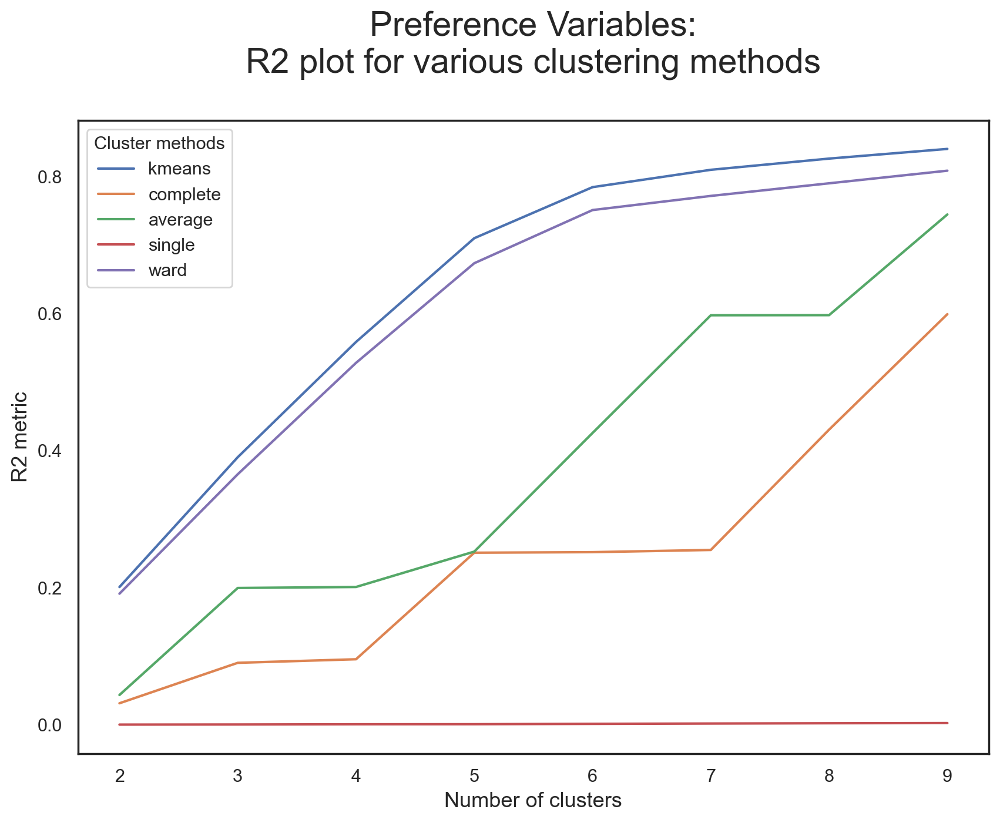

In [643]:
# Obtaining the R² scores for each cluster solution on preference variables
r2_scores_pref = {}
r2_scores_pref['kmeans'] = get_r2_scores(df_prf, preference_features, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores_pref[linkage] = get_r2_scores(
        df_prf, preference_features, hierarchical.set_params(linkage=linkage)
    )

# Visualizing the R² scores for each cluster solution on product variables
pd.DataFrame(r2_scores_pref).plot.line(figsize=(10,7))

plt.title("Preference Variables:\nR2 plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
plt.show()

By analysing the elbow of the $R^2$ plot, we choose a number of clusters K=5 for the preference features.

In [644]:
# Applying the right clustering (algorithm and number of clusters) for each perspective

kmeans_val = KMeans(
    n_clusters=4,
    init='k-means++',
    n_init=20,
    random_state=42
)
value_labels = kmeans_val.fit_predict(df_value)

kmeans_pref = KMeans(
    n_clusters=5,
    init='k-means++',
    n_init=20,
    random_state=42
)
preference_labels = kmeans_pref.fit_predict(df_prf)

dbscan_metric_features_scaled['value_labels'] = value_labels
dbscan_metric_features_scaled['preference_labels'] = preference_labels

In [645]:
pd.crosstab(dbscan_metric_features_scaled['value_labels'],
            dbscan_metric_features_scaled['preference_labels'])

preference_labels,0,1,2,3,4
value_labels,,,,,
0,719,717,1000,1971,667
1,2032,2736,727,2767,1989
2,603,290,331,742,310
3,5414,2936,325,1261,4095


<a class="anchor">

### Merging using Hierarchical clustering

In [646]:
# Centroids of the concatenated cluster labels
df_centroids = dbscan_metric_features_scaled.groupby(['value_labels', 'preference_labels'])\
    [perspective_features].mean()
df_centroids

proportion_CUI_western  orders_from_chain  \
value_labels preference_labels                                              
0            0                               -0.620514          -0.481566   
             1                                2.035234          -0.540788   
             2                               -0.627225          -0.508517   
             3                               -0.612639          -0.516878   
             4                               -0.615261          -0.533329   
1            0                               -0.404027          -0.101235   
             1                                1.680090          -0.237198   
             2                               -0.469607          -0.267613   
             3                               -0.436553          -0.209755   
             4                               -0.352883          -0.256529   
2            0                               -0.255466           2.796318   
             1                                1.390642           0.899275   
             2                               -0.491692           0.165267   
             3                               -0.433696           0.468306   
             4                               -0.296235           1.526546   
3            0                               -0.462189           0.339363   
             1                                1.794222          -0.196350   
             2                               -0.451776          -0.233289   
             3                               -0.469095          -0.195837   
             4                               -0.483809           0.164887   

                                total_money_spent  \
value_labels preference_labels                      
0            0                          -0.214660   
             1                          -0.301677   
             2                           0.111842   
             3                          -0.092541   
             4                          -0.237307   
1            0                           0.001777   
             1                          -0.037010   
             2                           0.175131   
             3                           0.091836   
             4                          -0.028017   
2            0                           2.750491   
             1                           2.298405   
             2                           2.625866   
             3                           2.572690   
             4                           2.483642   
3            0                          -0.380280   
             1                          -0.489351   
             2                          -0.506028   
             3                          -0.484758   
             4                          -0.394657   

                                proportion_CUI_Street Food / Snacks  \
value_labels preference_labels                                        
0            0                                            -0.293234   
             1                                            -0.314649   
             2                                             3.773002   
             3                                            -0.275939   
             4                                            -0.308328   
1            0                                            -0.265807   
             1                                            -0.276693   
             2                                             2.783240   
             3                                            -0.189616   
             4                                            -0.284775   
2            0                                            -0.171453   
             1                                            -0.200709   
             2                                             2.695275   
             3                                             0.083626   
             4                    

In [647]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
linkage = 'ward'
hclust = AgglomerativeClustering(
    linkage=linkage, 
    metric='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)

hclust_labels = hclust.fit_predict(df_centroids)

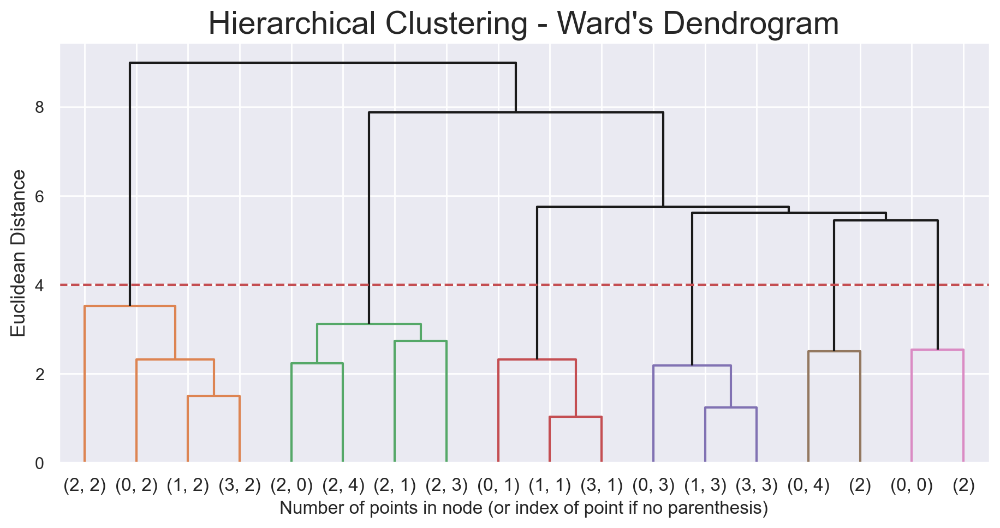

In [648]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned

y_threshold = 4

dendrogram(linkage_matrix, 
           truncate_mode='level', 
           labels=df_centroids.index, p=5, 
           color_threshold=y_threshold, 
           above_threshold_color='k')

plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [649]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    metric='euclidean', 
    n_clusters=6
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

proportion_CUI_western  orders_from_chain  \
value_labels preference_labels                                              
0            0                               -0.620514          -0.481566   
             1                                2.035234          -0.540788   
             2                               -0.627225          -0.508517   
             3                               -0.612639          -0.516878   
             4                               -0.615261          -0.533329   
1            0                               -0.404027          -0.101235   
             1                                1.680090          -0.237198   
             2                               -0.469607          -0.267613   
             3                               -0.436553          -0.209755   
             4                               -0.352883          -0.256529   
2            0                               -0.255466           2.796318   
             1                                1.390642           0.899275   
             2                               -0.491692           0.165267   
             3                               -0.433696           0.468306   
             4                               -0.296235           1.526546   
3            0                               -0.462189           0.339363   
             1                                1.794222          -0.196350   
             2                               -0.451776          -0.233289   
             3                               -0.469095          -0.195837   
             4                               -0.483809           0.164887   

                                total_money_spent  \
value_labels preference_labels                      
0            0                          -0.214660   
             1                          -0.301677   
             2                           0.111842   
             3                          -0.092541   
             4                          -0.237307   
1            0                           0.001777   
             1                          -0.037010   
             2                           0.175131   
             3                           0.091836   
             4                          -0.028017   
2            0                           2.750491   
             1                           2.298405   
             2                           2.625866   
             3                           2.572690   
             4                           2.483642   
3            0                          -0.380280   
             1                          -0.489351   
             2                          -0.506028   
             3                          -0.484758   
             4                          -0.394657   

                                proportion_CUI_Street Food / Snacks  \
value_labels preference_labels                                        
0            0                                            -0.293234   
             1                                            -0.314649   
             2                                             3.773002   
             3                                            -0.275939   
             4                                            -0.308328   
1            0                                            -0.265807   
             1                                            -0.276693   
             2                                             2.783240   
             3                                            -0.189616   
             4                                            -0.284775   
2            0                                            -0.171453   
             1                                            -0.200709   
             2                                             2.695275   
             3                                             0.083626   
             4                    

In [650]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()
cluster_mapper

{(0, 0): 1,
 (0, 1): 3,
 (0, 2): 0,
 (0, 3): 4,
 (0, 4): 5,
 (1, 0): 1,
 (1, 1): 3,
 (1, 2): 0,
 (1, 3): 4,
 (1, 4): 5,
 (2, 0): 2,
 (2, 1): 2,
 (2, 2): 0,
 (2, 3): 2,
 (2, 4): 2,
 (3, 0): 1,
 (3, 1): 3,
 (3, 2): 0,
 (3, 3): 4,
 (3, 4): 5}

In [651]:
df_ = dbscan_metric_features_scaled.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['value_labels'], row['preference_labels'])
    ], axis=1
)

df_ 

,proportion_CUI_western,orders_from_chain,total_money_spent,proportion_CUI_Street Food / Snacks,proportion_CUI_other_cuisines,proportion_CUI_popular_asian,proportion_CUI_asian,avg_spent_per_product,value_labels,preference_labels,merged_labels
customer_id,,,,,,,,,,,
1b8f824d5e,-0.682883,-0.459573,-0.206670,-0.324145,-0.748577,2.332624,-0.620685,-0.443436,3,4,5
5d272b9dcb,1.234798,-0.208575,-0.414870,-0.324145,-0.748577,-0.675067,0.375436,0.501191,1,1,3
f6d1b2ba63,2.190646,-0.208575,-0.630391,-0.324145,-0.748577,-0.675067,-0.620685,-0.733559,3,1,3
180c632ed8,-0.682883,-0.459573,-0.148968,-0.324145,-0.748577,1.027004,0.679251,0.726924,1,4,5
4eb37a6705,0.072299,-0.710570,0.365180,-0.324145,-0.748577,-0.675067,1.586913,0.867052,1,3,4
...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,-0.682883,-0.459573,-0.440061,-0.324145,2.102442,-0.675067,-0.620685,2.582133,0,0,1
f6b6709018,2.190646,-0.710570,-0.440061,-0.324145,-0.748577,-0.675067,-0.620685,2.582133,0,1,3
f74ad8ce3f,-0.682883,-0.459573,-0.445444,-0.324145,2.102442,-0.675067,-0.620685,2.520457,0,0,1


In [652]:
# Merged cluster centroids
df_.groupby('merged_labels').mean(numeric_only=True)[perspective_features]

,proportion_CUI_western,orders_from_chain,total_money_spent,proportion_CUI_Street Food / Snacks,proportion_CUI_other_cuisines,proportion_CUI_popular_asian,proportion_CUI_asian,avg_spent_per_product
merged_labels,,,,,,,,
0,-0.536385,-0.303898,0.396082,3.242338,-0.591770,-0.565643,-0.295358,0.900514
1,-0.461657,0.157423,-0.270615,-0.281976,1.481477,-0.411587,-0.487849,-0.417356
2,-0.084522,1.422973,2.572724,-0.088257,-0.099351,-0.096912,0.344431,0.227230
3,1.772394,-0.252497,-0.274581,-0.285247,-0.587200,-0.530089,-0.523124,-0.082101
4,-0.501247,-0.307736,-0.089943,-0.240327,-0.572446,-0.523172,1.795676,0.573389
5,-0.458223,-0.028256,-0.271090,-0.295073,-0.490978,1.691598,-0.505431,-0.309621


In [653]:
# Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_.groupby('merged_labels')\
    .size()\
    .to_frame()

df_counts

,0
merged_labels,
0,2383
1,8165
2,1945
3,6389
4,5999
5,6751


In [654]:
# Getting the preference and value labels
df_counts = df_counts\
    .rename({v:k for k, v in cluster_mapper.items()})\
    .reset_index()

df_counts

,merged_labels,0
0,"(3, 2)",2383
1,"(3, 0)",8165
2,"(2, 4)",1945
3,"(3, 1)",6389
4,"(3, 3)",5999
5,"(3, 4)",6751


In [655]:
df_counts['value_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['preference_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])

df_counts

,merged_labels,0,value_labels,preference_labels
0,"(3, 2)",2383,3,2
1,"(3, 0)",8165,3,0
2,"(2, 4)",1945,2,4
3,"(3, 1)",6389,3,1
4,"(3, 3)",5999,3,3
5,"(3, 4)",6751,3,4


In [656]:
df_counts.pivot(values=0, index='value_labels', columns='preference_labels')

preference_labels,0,1,2,3,4
value_labels,,,,,
2,NaN,NaN,NaN,NaN,1945.0
3,8165.0,6389.0,2383.0,5999.0,6751.0


In [657]:
# Setting df to have the final product, behavior and merged clusters
df = df_.copy()

<a class="anchor">

## 3.8. Cluster Analysis

In [658]:
def cluster_profiles(df, label_columns, figsize, 
                     cmap="tab10",
                     compare_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    
    if compare_titles == None:
        compare_titles = [""]*len(label_columns)
        
    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=2, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compare_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, 
                                            label, 
                                            color = sns.color_palette(cmap),
                                            ax=ax[0])

        sns.barplot(x=label, 
                    hue=label,
                    y="counts", 
                    data=counts, 
                    ax=ax[1], 
                    palette=sns.color_palette(cmap),
                    legend=False
                    )

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), 
                              rotation=40,
                              ha='right'
                              )
        
        ax[0].legend(handles, cluster_labels,
                     loc='center left', bbox_to_anchor=(1, 0.5), title=label
                     ) # Adaptable to number of clusters
        
        ax[1].set_xticks([i for i in range(len(handles))])
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        
    # plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profiling", fontsize=23)
    plt.show()

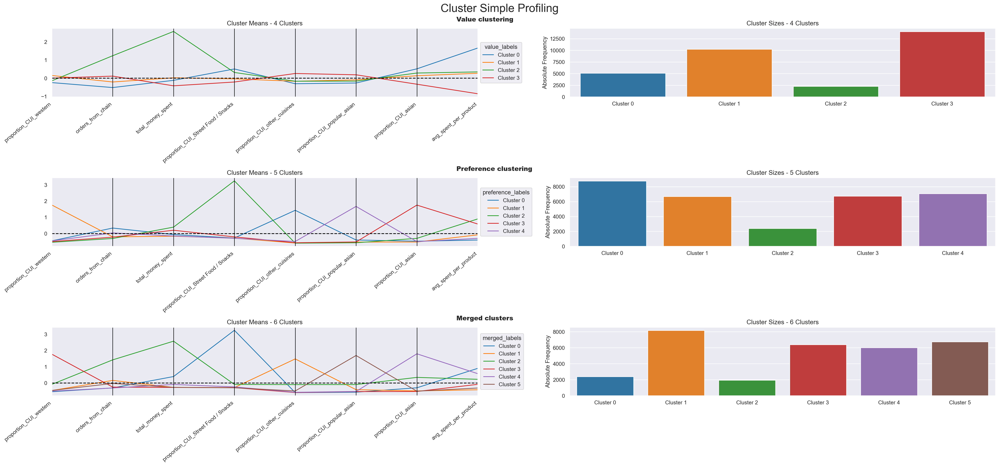

In [659]:
# Profilling each cluster (preference, value, merged)
cluster_profiles(
    df = df[perspective_features + ['value_labels','preference_labels','merged_labels']], 
    label_columns = ['value_labels','preference_labels','merged_labels'], 
    figsize = (28, 13), 
    compare_titles = [ "Value clustering","Preference clustering","Merged clusters"]
)

<a class="anchor">

# 4. Profilling 

Clusters size

In [660]:
df['merged_labels'].value_counts()

merged_labels
1    8165
5    6751
3    6389
4    5999
0    2383
2    1945
Name: count, dtype: int64

In [661]:
df_profiling['merged_labels'] = df['merged_labels']

Total Money Spent analysis

In [663]:
df_profiling.groupby('merged_labels')['total_money_spent'].sum().sort_values(ascending=False)

merged_labels
2.0    307253.55
1.0    211555.66
4.0    205774.53
5.0    174769.61
3.0    164362.39
0.0    135533.79
Name: total_money_spent, dtype: float64

In [664]:
df_profiling.groupby('merged_labels')['total_money_spent'].mean().sort_values(ascending=False)

merged_labels
2.0    157.970977
0.0     56.875279
4.0     34.301472
1.0     25.910062
5.0     25.887959
3.0     25.725840
Name: total_money_spent, dtype: float64

Total Orders Analysis

In [665]:
df_profiling.groupby('merged_labels')['total_orders'].sum().sort_values(ascending=False)

merged_labels
1.0    35114
2.0    29154
5.0    25897
3.0    20743
4.0    18026
0.0     8059
Name: total_orders, dtype: int64

In [666]:
df_profiling.groupby('merged_labels')['total_orders'].mean().sort_values(ascending=False)

merged_labels
2.0    14.989203
1.0     4.300551
5.0     3.836024
0.0     3.381872
3.0     3.246674
4.0     3.004834
Name: total_orders, dtype: float64

Analysis of the weight of the prefered cuisines of each cluster

In [736]:
CUI_Aggregated

['CUI_Popular_Asian',
 'CUI_Western',
 'CUI_Other_Cuisines',
 'CUI_Street Food / Snacks',
 'CUI_Asian']

Cluster 0 - Preference for Street Food / Snacks Cuisine

In [738]:
((df_profiling[df_profiling['merged_labels'] == 0][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 0]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Street Food / Snacks    69.521283
CUI_Asian                   14.729242
CUI_Other_Cuisines           5.998873
CUI_Western                  5.675714
CUI_Popular_Asian            4.074888
dtype: float64

Cluster 1 - Preference for Other Cuisines

In [739]:
((df_profiling[df_profiling['merged_labels'] == 1][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 1]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Other_Cuisines          70.413469
CUI_Popular_Asian           11.404871
CUI_Western                  9.957417
CUI_Asian                    6.821363
CUI_Street Food / Snacks     1.402879
dtype: float64

In [729]:
((df_profiling[df_profiling['merged_labels'] == 1][['CUI_OTHER', 'CUI_Cafe', 'CUI_Beverages', 'CUI_Desserts', 'CUI_Healthy', "CUI_Chicken Dishes"]].sum()/df_profiling[df_profiling['merged_labels'] == 1]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_OTHER             25.339818
CUI_Beverages         18.842540
CUI_Chicken Dishes     7.884261
CUI_Healthy            7.296297
CUI_Desserts           6.035712
CUI_Cafe               5.014841
dtype: float64

Cluster 2 - Not a significant preference for one Cuisine

In [740]:
((df_profiling[df_profiling['merged_labels'] == 2][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 2]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Asian                   32.547751
CUI_Other_Cuisines          23.083684
CUI_Western                 20.283037
CUI_Popular_Asian           18.816573
CUI_Street Food / Snacks     5.268955
dtype: float64

CLuster 3 - Preference for Western Cuisine

In [741]:
((df_profiling[df_profiling['merged_labels'] == 3][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 3]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Western                 80.655830
CUI_Other_Cuisines           6.773393
CUI_Popular_Asian            6.430662
CUI_Asian                    5.043690
CUI_Street Food / Snacks     1.096425
dtype: float64

In [731]:
((df_profiling[df_profiling['merged_labels'] == 3][['CUI_American','CUI_Italian']].sum()/df_profiling[df_profiling['merged_labels'] == 3]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_American    43.905245
CUI_Italian     36.750585
dtype: float64

Cluster 4 - Preference for Asian Cuisine

In [742]:
((df_profiling[df_profiling['merged_labels'] == 4][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 4]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Asian                   77.585754
CUI_Western                  7.179392
CUI_Other_Cuisines           6.856383
CUI_Popular_Asian            5.689110
CUI_Street Food / Snacks     2.689361
dtype: float64

Cluster 5 - Preference for the Popular Asian Cuisines

In [743]:
((df_profiling[df_profiling['merged_labels'] == 5][CUI_Aggregated].sum()/df_profiling[df_profiling['merged_labels'] == 5]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Popular_Asian           72.913094
CUI_Other_Cuisines          10.608555
CUI_Western                  9.918286
CUI_Asian                    5.632861
CUI_Street Food / Snacks     0.927204
dtype: float64

In [735]:
((df_profiling[df_profiling['merged_labels'] == 5][['CUI_Japanese', 'CUI_Chinese', 'CUI_Thai', 'CUI_Indian', 'CUI_Noodle Dishes']].sum()/df_profiling[df_profiling['merged_labels'] == 5]['total_money_spent'].sum())*100).sort_values(ascending=False)

CUI_Japanese         25.832077
CUI_Indian           17.769016
CUI_Chinese          13.281834
CUI_Noodle Dishes     8.209620
CUI_Thai              7.820547
dtype: float64

<a class="anchor">

## 4.1. Non used metric features

In [702]:
df_copy = df.copy()

In [703]:
columns_to_add = [col for col in metric_features_scaled_profiling.columns if col not in perspective_features]

not_used_metric_features = metric_features_scaled_profiling[columns_to_add]

df_copy = df_copy.join(not_used_metric_features)

In [704]:
columns_to_revert = columns_to_add

scaler_columns = scaler.feature_names_in_
selected_indices = [scaler_columns.tolist().index(col) for col in columns_to_revert]

means = scaler.mean_[selected_indices]
scales = scaler.scale_[selected_indices]

df_copy[columns_to_revert] = df_copy[columns_to_revert] * scales + means

In [705]:
df_unused_metric_mean = df_copy[['merged_labels'] + columns_to_revert].groupby(['merged_labels']).mean()

df_unused_metric_mean

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,weekdays,weekend,CUI_Popular_Asian,CUI_Western,CUI_Other_Cuisines,total_orders,avg_spent_per_order,different_CUI,customer_time,customer_frequency,avg_products_per_order,off_peak_hours,peak_hours,proportion_off_peak_hours,proportion_peak_hours
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,27.594629,2.738565,5.216953,1.620227,31.025178,62.433907,2.994301,8.377298,1.707612,0.018947,0.058489,0.485485,1.118674,0.331129,0.077491,0.233777,1.692866,0.028775,0.177025,39.540424,0.032988,2.375577,1.006295,2.317604,3.228078,3.411876,3.381872,19.274779,2.098196,31.408728,0.197726,1.612020,1.928242,1.453630,0.549348,0.450652
1,27.445560,3.269075,5.306307,3.458175,27.555664,63.423760,1.742802,1.767419,4.882114,1.299348,2.042817,0.618971,1.563857,1.890475,0.598154,0.837171,0.898697,0.456724,6.565563,0.363487,0.382463,3.077771,1.222780,2.955009,2.579973,18.244174,4.300551,7.562060,2.526393,35.868096,0.173648,1.245773,1.932517,2.368034,0.465449,0.534551
2,27.751054,8.324936,21.124936,8.500257,10.518252,81.876093,18.969578,51.416000,8.256093,5.544884,1.725342,5.714488,4.072134,4.786771,5.975311,13.071733,12.976900,1.764380,12.080298,8.323419,3.293645,10.696658,4.292545,29.724725,32.041311,36.465522,14.989203,13.301630,4.261183,71.357841,0.308334,1.505404,6.936247,8.052956,0.501504,0.498496
3,27.566129,2.279073,3.865550,1.825012,29.688371,61.378620,11.294993,1.297532,0.259590,0.219308,0.116840,0.168421,0.088602,0.181343,0.365059,9.454397,0.736957,0.032914,0.876829,0.282064,0.350991,2.316951,0.929723,1.654342,20.749390,1.742512,3.246674,8.854343,1.800595,31.690249,0.147403,1.193610,1.187979,2.058695,0.377173,0.622827
4,27.561494,2.456409,3.789298,1.604934,32.059177,62.225871,2.078106,26.613056,1.112042,0.053452,0.084624,0.379298,0.503172,0.262267,0.196448,0.384531,1.186021,0.050675,0.336283,0.922490,0.139007,2.122187,0.882647,1.951449,2.462637,2.351840,3.004834,13.261145,1.805801,30.166694,0.171950,1.294694,1.712952,1.291882,0.581941,0.418059
5,27.409362,2.870686,4.893053,2.718412,28.794401,62.893794,1.598834,1.458233,0.534315,0.178708,0.419289,3.438396,0.139259,0.261918,4.600036,0.968808,6.687397,2.125303,1.212848,0.240034,2.024580,2.714709,1.121315,18.875712,2.567642,2.746338,3.836024,8.328098,2.354910,34.099393,0.175325,1.297804,1.549696,2.286328,0.397910,0.602090


In [706]:
df_unused_metric_sum = df_copy[['merged_labels'] + columns_to_revert].groupby(['merged_labels']).sum()

df_unused_metric_sum

,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,weekdays,weekend,CUI_Popular_Asian,CUI_Western,CUI_Other_Cuisines,total_orders,avg_spent_per_order,different_CUI,customer_time,customer_frequency,avg_products_per_order,off_peak_hours,peak_hours,proportion_off_peak_hours,proportion_peak_hours
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,65758.0,6526.0,12432.0,3861.0,73933.0,148780.0,7135.42,19963.10,4069.24,45.15,139.38,1156.91,2665.80,789.08,184.66,557.09,4034.10,68.57,421.85,94224.83,78.61,5661.0,2398.0,5522.85,7692.51,8130.50,8059.0,45931.798985,5000.0,74847.0,471.181296,3841.443889,4595.0,3464.0,1309.096649,1073.903351
1,224093.0,26692.0,43326.0,28236.0,224992.0,517855.0,14229.98,14430.98,39862.46,10609.18,16679.60,5053.90,12768.89,15435.73,4883.93,6835.50,7337.86,3729.15,53607.82,2967.87,3122.81,25130.0,9984.0,24127.65,21065.48,148963.68,35114.0,61744.223810,20628.0,292863.0,1417.837816,10171.740612,15779.0,19335.0,3800.391583,4364.608417
2,53975.8,16192.0,41088.0,16533.0,20458.0,159249.0,36895.83,100004.12,16058.10,10784.80,3355.79,11114.68,7920.30,9310.27,11621.98,25424.52,25240.07,3431.72,23496.18,16189.05,6406.14,20805.0,8349.0,57814.59,62320.35,70925.44,29154.0,25871.669732,8288.0,138791.0,599.709570,2928.011515,13491.0,15663.0,975.425399,969.574601
3,176120.0,14561.0,24697.0,11660.0,189679.0,392148.0,72163.71,8289.93,1658.52,1401.16,746.49,1076.04,566.08,1158.60,2332.36,60404.14,4708.42,210.29,5602.06,1802.11,2242.48,14803.0,5940.0,10569.59,132567.85,11132.91,20743.0,56570.397034,11504.0,202469.0,941.755138,7625.976647,7590.0,13153.0,2409.760695,3979.239305
4,165341.4,14736.0,22732.0,9628.0,192323.0,373293.0,12466.56,159651.72,6671.14,320.66,507.66,2275.41,3018.53,1573.34,1178.49,2306.80,7114.94,304.00,2017.36,5534.02,833.90,12731.0,5295.0,11706.74,14773.36,14108.69,18026.0,79553.606442,10833.0,180970.0,1031.526885,7766.871039,10276.0,7750.0,3491.063199,2507.936801
5,185040.6,19380.0,33033.0,18352.0,194391.0,424596.0,10793.73,9844.53,3607.16,1206.46,2830.62,23212.61,940.14,1768.21,31054.84,6540.42,45146.62,14347.92,8187.94,1620.47,13667.94,18327.0,7570.0,127429.93,17334.15,18540.53,25897.0,56222.992093,15898.0,230205.0,1183.616946,8761.476610,10462.0,15435.0,2686.288747,4064.711253


 <a class="anchor">
 
 ## 4.2. Categorical Features

### Customer Region

In [707]:
# Select the desired features from df_pre
features_to_add = [
    'oh_customer_region_2360',
    'oh_customer_region_2490',
    'oh_customer_region_4140',
    'oh_customer_region_4660',
    'oh_customer_region_8370',
    'oh_customer_region_8550',
    'oh_customer_region_8670',
    'oh_customer_region_8000'
]
selected_features = df_profiling[features_to_add]

aligned_features = selected_features.loc[df.index]

# Add the features to df
df_copy = df_copy.join(aligned_features)

In [708]:
df_region = df_copy[['merged_labels',
            'oh_customer_region_2360',
            'oh_customer_region_2490',
            'oh_customer_region_4140',
            'oh_customer_region_4660',
            'oh_customer_region_8370',
            'oh_customer_region_8550',
            'oh_customer_region_8670',
            'oh_customer_region_8000']].groupby(['merged_labels']).sum()

df_region

,oh_customer_region_2360,oh_customer_region_2490,oh_customer_region_4140,oh_customer_region_4660,oh_customer_region_8370,oh_customer_region_8550,oh_customer_region_8670,oh_customer_region_8000
merged_labels,,,,,,,,
0,108.0,15.0,71.0,116.0,96.0,4.0,1868.0,82.0
1,3906.0,247.0,89.0,1655.0,66.0,2.0,1419.0,76.0
2,217.0,5.0,27.0,743.0,29.0,1.0,862.0,35.0
3,916.0,44.0,520.0,3785.0,44.0,2.0,886.0,43.0
4,543.0,26.0,30.0,1121.0,227.0,4.0,3779.0,165.0
5,3108.0,107.0,118.0,2084.0,33.0,0.0,785.0,41.0


In [709]:
features_to_add_promo_original = [
    'last_promo',
    'customer_region',
    'payment_method'
]
selected_features = df_profiling[features_to_add_promo_original]

aligned_features = selected_features.loc[df.index]

# Add the features to df
df_copy = df_copy.join(aligned_features)

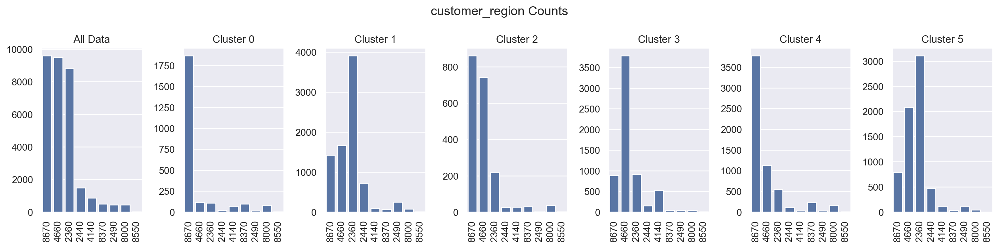

In [710]:
fig, axes = plt.subplots(1, 
                         df_copy['merged_labels'].nunique() + 1, # Add an extra ax for population countplot
                         figsize=(16,4),
                         tight_layout=True,
                        #  sharey=True,
                         )


for i in range(len(axes.flatten())): 
    ax = axes[i]
    if i == 0:
        sns.countplot(df_copy, 
                        x='customer_region', 
                        order = df_copy['customer_region'].value_counts().index,
                        ax=ax)
        ax.set_title("All Data")
        
    else:    
        sns.countplot(df_copy.loc[df_copy['merged_labels']==i-1], 
                    x='customer_region', 
                    order = df_copy['customer_region'].value_counts().index,
                    ax=ax)
        ax.set_title("Cluster {}".format(i-1))
    
    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.suptitle("customer_region Counts", )
plt.show()

### Last Promo

In [711]:
# Select the desired features from df_pre
features_to_add_promo = [
    'oh_last_promo_DELIVERY',
    'oh_last_promo_DISCOUNT',
    'oh_last_promo_FREEBIE',
    'oh_last_promo_NO PROMO USED'
]
selected_features = df_profiling[features_to_add_promo]

aligned_features = selected_features.loc[df.index]

# Add the features to df
df_copy = df_copy.join(aligned_features)

In [712]:
df_promo = df_copy[['merged_labels',
                'oh_last_promo_DELIVERY',
                'oh_last_promo_DISCOUNT',
                'oh_last_promo_FREEBIE',
                'oh_last_promo_NO PROMO USED']].groupby(['merged_labels']).sum()

df_promo

,oh_last_promo_DELIVERY,oh_last_promo_DISCOUNT,oh_last_promo_FREEBIE,oh_last_promo_NO PROMO USED
merged_labels,,,,
0,535.0,267.0,353.0,1228.0
1,1696.0,1214.0,1164.0,4091.0
2,172.0,199.0,252.0,1322.0
3,1027.0,1002.0,732.0,3628.0
4,1289.0,791.0,941.0,2978.0
5,1495.0,981.0,883.0,3392.0


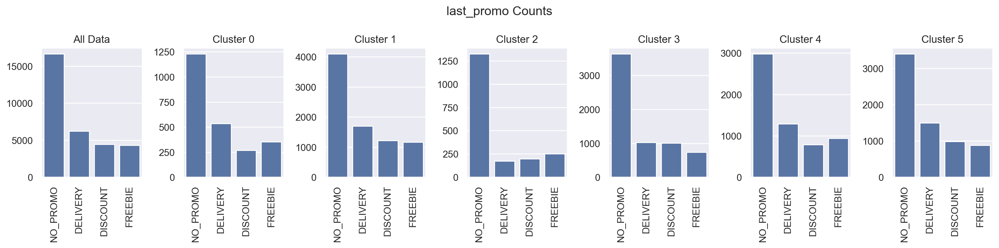

In [713]:
fig, axes = plt.subplots(1, 
                         df_copy['merged_labels'].nunique() + 1, # Add an extra ax for population countplot
                         figsize=(16,4),
                         tight_layout=True,
                        #  sharey=True,
                         )

for i in range(len(axes.flatten())): 
    ax = axes[i]
    if i == 0:
        sns.countplot(df_copy, 
                        x='last_promo', 
                        order = df_copy['last_promo'].value_counts().index,
                        ax=ax)
        ax.set_title("All Data")
        
    else:    
        sns.countplot(df_copy.loc[df_copy['merged_labels']==i-1], 
                    x='last_promo', 
                    order = df_copy['last_promo'].value_counts().index,
                    ax=ax)
        ax.set_title("Cluster {}".format(i-1))
    
    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.suptitle("last_promo Counts", )
plt.show()

### Payment Method

In [714]:
# Select the desired features from df_pre
features_to_add_promo = [
    'oh_payment_method_CARD',
    'oh_payment_method_CASH',
    'oh_payment_method_DIGI',
]
selected_features = df_profiling[features_to_add_promo]

aligned_features = selected_features.loc[df.index]

# Add the features to df
df_copy = df_copy.join(aligned_features)

In [715]:
df_payment = df_copy[['merged_labels',
                'oh_payment_method_CARD',
                'oh_payment_method_CASH',
                'oh_payment_method_DIGI']].groupby(['merged_labels']).sum()

df_payment

,oh_payment_method_CARD,oh_payment_method_CASH,oh_payment_method_DIGI
merged_labels,,,
0,1450.0,382.0,551.0
1,5039.0,1549.0,1577.0
2,1457.0,227.0,261.0
3,4305.0,1075.0,1009.0
4,3669.0,1079.0,1251.0
5,4112.0,1252.0,1387.0


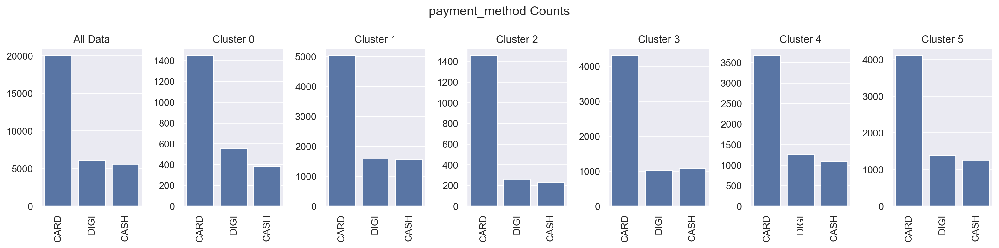

In [716]:
fig, axes = plt.subplots(1, 
                         df_copy['merged_labels'].nunique() + 1, # Add an extra ax for population countplot
                         figsize=(16,4),
                         tight_layout=True,
                        #  sharey=True,
                         )

for i in range(len(axes.flatten())): 
    ax = axes[i]
    if i == 0:
        sns.countplot(df_copy, 
                        x='payment_method', 
                        order = df_copy['payment_method'].value_counts().index,
                        ax=ax)
        ax.set_title("All Data")
        
    else:    
        sns.countplot(df_copy.loc[df_copy['merged_labels']==i-1], 
                    x='payment_method', 
                    order = df_copy['payment_method'].value_counts().index,
                    ax=ax)
        ax.set_title("Cluster {}".format(i-1))
    
    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.suptitle("payment_method Counts", )
plt.show()

<a class="anchor">

## 4.3. Cluster visualization

<a class="anchor">

### 4.3.1. t-SNE

In [684]:
# This is step can be quite time consuming
two_dim = TSNE(random_state=42).fit_transform(df[perspective_features])

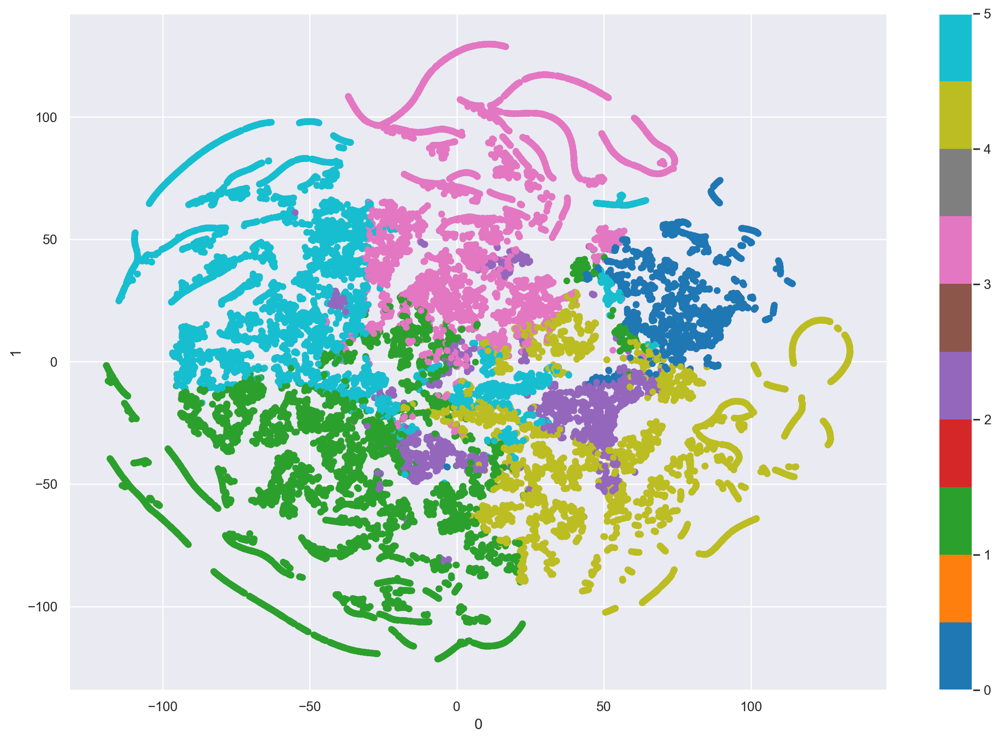

In [685]:
# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

<a class="anchor">

### 4.3.2.UMAP

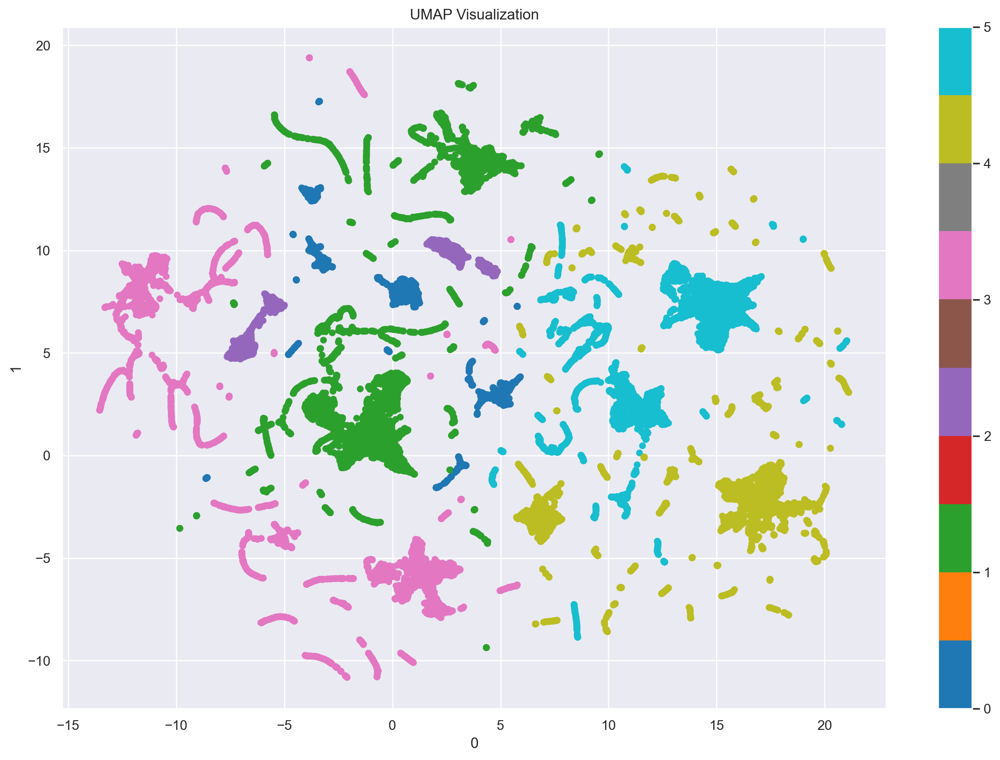

In [686]:
# Perform UMAP dimensionality reduction
umap_reducer = umap.UMAP(random_state=42)
two_dim_umap = umap_reducer.fit_transform(df)

# UMAP visualization
pd.DataFrame(two_dim_umap).plot.scatter(
    x=0, y=1, c=df['merged_labels'], colormap='tab10', figsize=(15, 10)
)
plt.title("UMAP Visualization")
plt.show()

<a class="anchor">

# 5. Assess feature importance and reclassify outliers

<a class="anchor">

## 5.1. Feature Importance

<a class="anchor">

### 5.1.1. Using the R²

What proportion of each variables total SS is explained between clusters?

In [687]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

In [688]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(df[perspective_features + ['merged_labels']], 'merged_labels').drop('merged_labels')

proportion_CUI_western                 0.803607
orders_from_chain                      0.194811
total_money_spent                      0.550807
proportion_CUI_Street Food / Snacks    0.858725
proportion_CUI_other_cuisines          0.776622
proportion_CUI_popular_asian           0.787594
proportion_CUI_asian                   0.796311
avg_spent_per_product                  0.193357
dtype: float64

Which features are actually separating our clusters. We can see that our cuisines have very high R2.

<a class="anchor">

### 5.1.2. Using a Decision Tree

We get the normalized total reduction of the criterion (gini or entropy) brought by that feature (also known as Gini importance).

In [689]:
# Preparing the data
X = df[perspective_features]
y = df.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 82.74% of the customers correctly


In [690]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns).sort_values(ascending=False)

proportion_CUI_other_cuisines          0.345138
proportion_CUI_western                 0.310060
proportion_CUI_popular_asian           0.277529
total_money_spent                      0.060914
proportion_CUI_asian                   0.006290
avg_spent_per_product                  0.000069
orders_from_chain                      0.000000
proportion_CUI_Street Food / Snacks    0.000000
dtype: float64

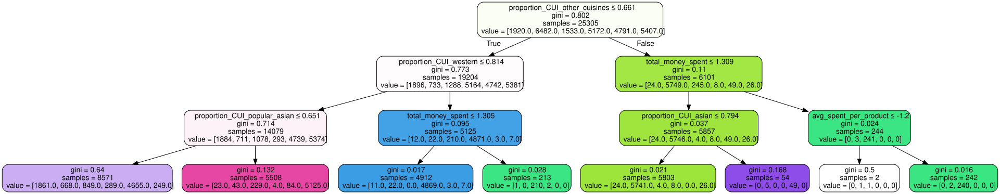

In [691]:
# Visualizing the decision tree
dot_data = export_graphviz(dt, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)
g = graphviz.Source(dot_data)

g

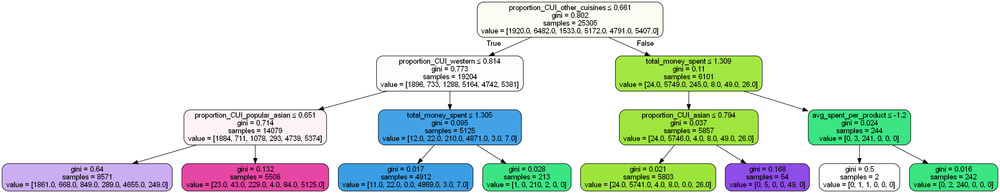

In [692]:
png_bytes = g.pipe(format='png')
with open('dt.png','wb') as f:
    f.write(png_bytes)

Image(png_bytes)

<a class="anchor">

## 5.2. Reclassify Outliers

In [693]:
# Predicting the cluster labels of the outliers
df_out['merged_labels'] = dt.predict(df_out[perspective_features])
df_out.head()

,proportion_CUI_western,orders_from_chain,total_money_spent,proportion_CUI_Street Food / Snacks,proportion_CUI_other_cuisines,proportion_CUI_popular_asian,proportion_CUI_asian,avg_spent_per_product,dbscan_labels,merged_labels
customer_id,,,,,,,,,,
249ba584d3,-0.676331,1.297409,18.718218,-0.324145,-0.720063,-0.675067,2.337134,0.489206,-1,4
0077c28499,-0.542964,3.556387,12.542837,0.676432,-0.329445,0.208730,0.278649,0.525553,-1,4
6f7904b7dd,-0.195408,15.604266,4.981752,-0.324145,0.647985,0.342728,-0.614360,-1.075831,-1,4
7d989d40a2,-0.682883,-0.710570,8.551080,-0.324145,-0.748577,2.332624,-0.620685,-0.507966,-1,5
733ef62d70,0.333388,10.584316,6.364872,-0.324145,0.330816,-0.630146,0.136345,-0.447299,-1,4


<a class="anchor">

### 5.2.1. Without Outliers

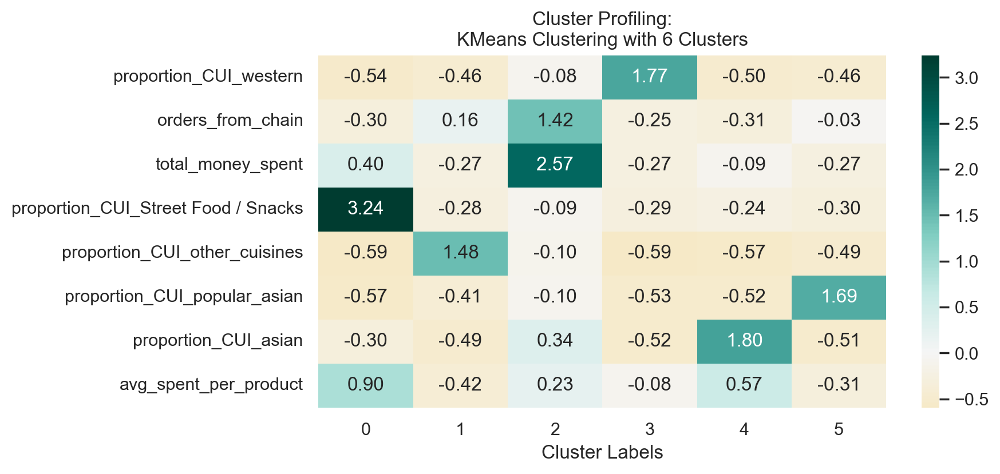

In [694]:
fig, ax = plt.subplots(figsize=(8,4))

km_profile = df.groupby('merged_labels')[perspective_features].mean().T

sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=ax 
            )

ax.set_xlabel("Cluster Labels")
ax.set_title("Cluster Profiling:\nKMeans Clustering with 6 Clusters")
plt.show()

<a class="anchor">

### 5.2.2. Outliers

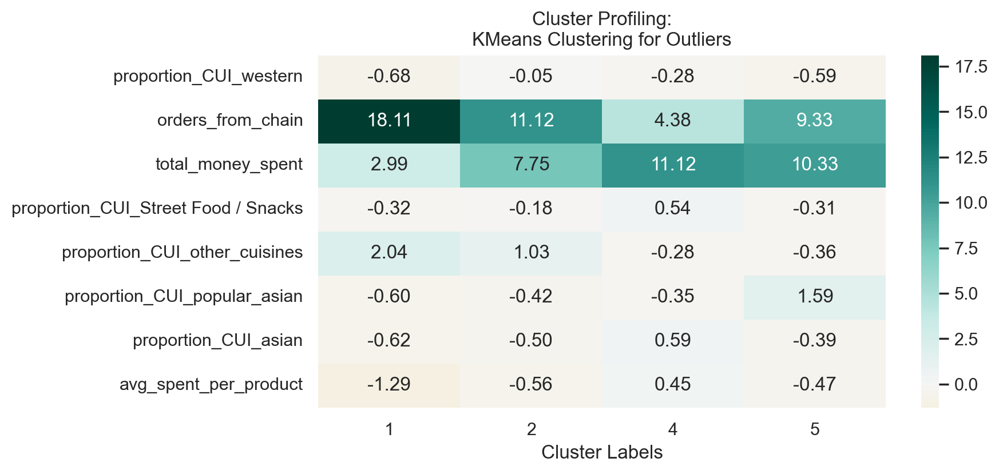

In [695]:
fig, ax = plt.subplots(figsize=(8,4))

km_profile = df_out.groupby('merged_labels')[perspective_features].mean().T

sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=ax 
            )

ax.set_xlabel("Cluster Labels")
ax.set_title("Cluster Profiling:\nKMeans Clustering for Outliers")
plt.show()

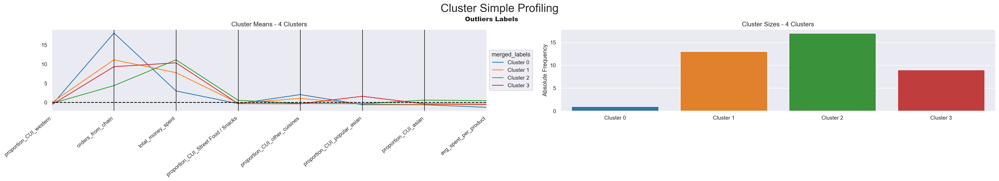

In [696]:
# Profilling each cluster (preference, value, merged)
cluster_profiles(
    df_out[perspective_features + ['merged_labels']], 
    label_columns=['merged_labels'], 
    figsize=(28, 5), 
    compare_titles=["Outliers Labels"]
)

In [697]:
df_out['merged_labels'].value_counts().sum()

40

In [698]:
df_out.groupby('merged_labels')['total_money_spent'].sum().sum()

385.75273193365183